In [1]:
import numpy as np
import cv2 as cv
import os
from matplotlib import pyplot as plt
%matplotlib inline
import math
import pytesseract 
pytesseract.pytesseract.tesseract_cmd = r'C:\Program Files (x86)\Tesseract-OCR\tesseract.exe'

In [2]:
def SearchOfCard(passContours):
    suitableContours = []
    for c in passContours:
        perimeter = cv.arcLength(c, True)
        oneContour = cv.approxPolyDP(c, 0.08 * perimeter, True)
        if len(oneContour) == 4:
            suitableContours.append(oneContour)
    #print(len(suitableContours))
    
    if len(suitableContours) == 0:
        return
    
    bigContour = suitableContours[0]
    area = 0
    for c in suitableContours:
        currentArea = cv.contourArea(c)
        if currentArea > area:
            area = currentArea
            bigContour = c
    return [bigContour] 

In [3]:
def sortPoints(contour):
    indexes = []
    minDist = math.sqrt((contour[0][0][0])**2+(contour[0][0][1])**2)
    index = 0

    for i in range(1,len(contour)):
        dist = math.sqrt((contour[i][0][0])**2+(contour[i][0][1])**2)
        if minDist > dist:
            minDist = dist
            index = i

    indexes.append(index)

    maxDist = math.sqrt((contour[0][0][0])**2+(contour[0][0][1])**2)
    index = 0
        
    for i in range(1,len(contour)):
        dist = math.sqrt((contour[i][0][0])**2+(contour[i][0][1])**2)
        if maxDist < dist:
            maxDist = dist
            index = i
    
    indexes.append(index)
    indexes2 = indexes.copy()
 
    flag = True

    for i in range(len(contour)): 
        if flag and not(i in indexes):
            indexes.insert(1,i)
            indexes2.insert(1,i)
            dist1 = math.sqrt((contour[i][0][0] - contour[indexes[0]][0][0])**2+(contour[i][0][1]- contour[indexes[0]][0][1])**2)
            flag = False
        elif not(i in indexes):
            dist2 = math.sqrt((contour[i][0][0]- contour[indexes[0]][0][0])**2+(contour[i][0][1]- contour[indexes[0]][0][1])**2)
            if dist2 < dist1:
                indexes.insert(2,i)
                indexes2.insert(1,i)
            else:
                indexes.insert(1,i)
                indexes2.insert(2,i)
 
    allPoints =[]
    points = []
    
    for i in range(2):
        for i in indexes:
            points.append(contour[i][0])
        allPoints.append(points)
        indexes = indexes2
        points = []

    return allPoints   

In [4]:
path = os.getcwd()
directory = path + '\\Good'
files = os.listdir(directory)
images = filter(lambda x: x.endswith('.jpg'), files)
images = list(images)

name = 'res'
if not os.path.exists(name):
    os.mkdir(name)
result = path + '\\' + name

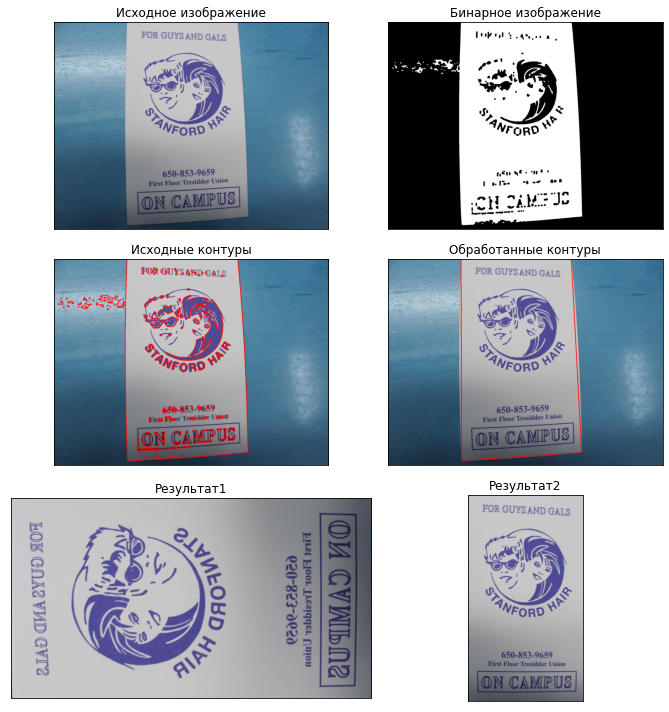

__________________________________________________________________________________


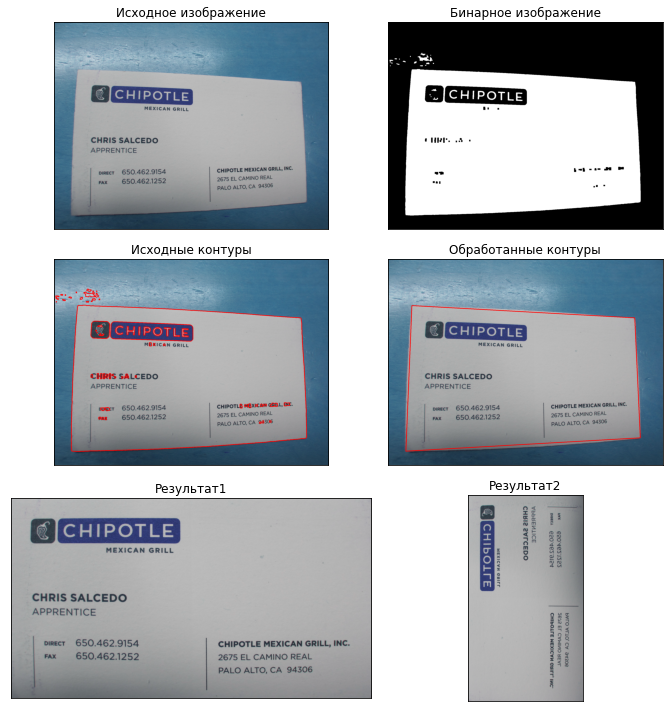

__________________________________________________________________________________


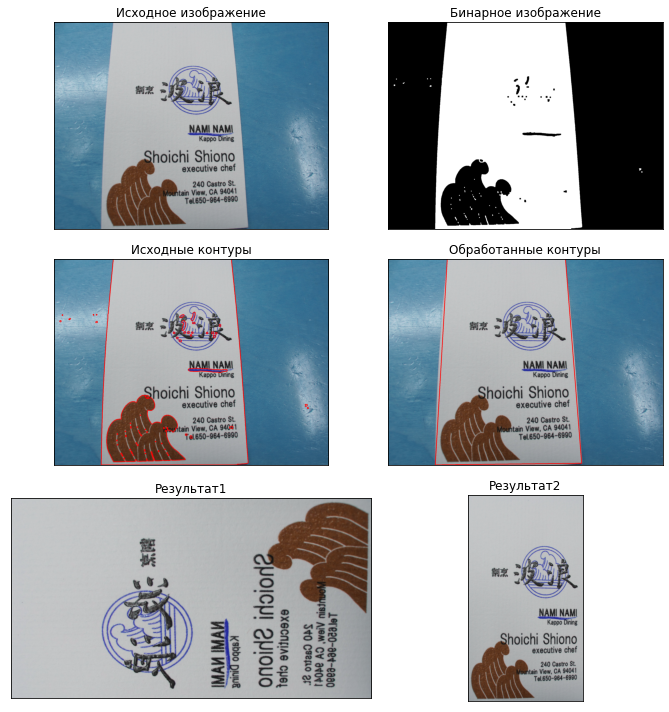

__________________________________________________________________________________


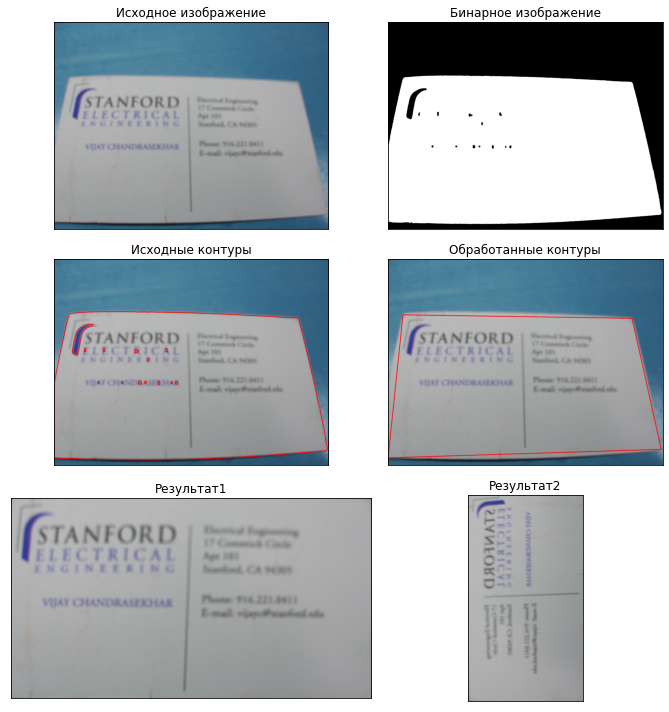

__________________________________________________________________________________


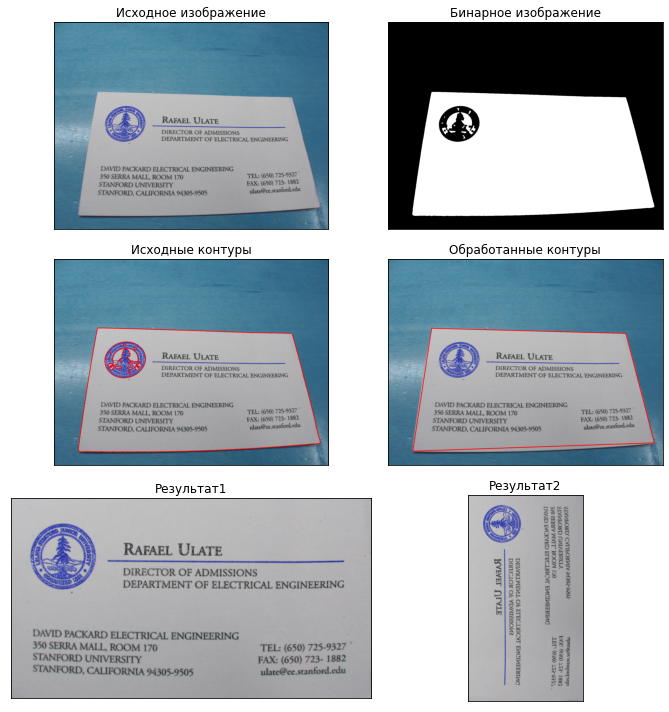

__________________________________________________________________________________


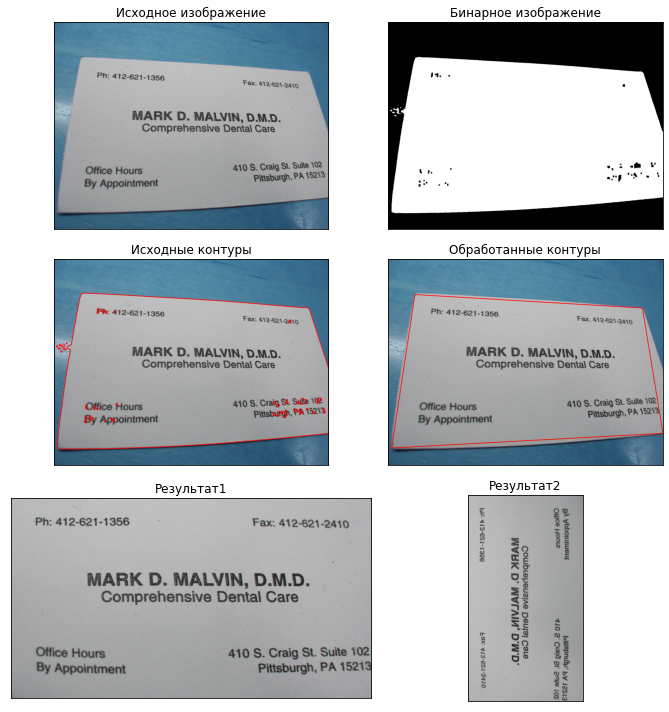

__________________________________________________________________________________


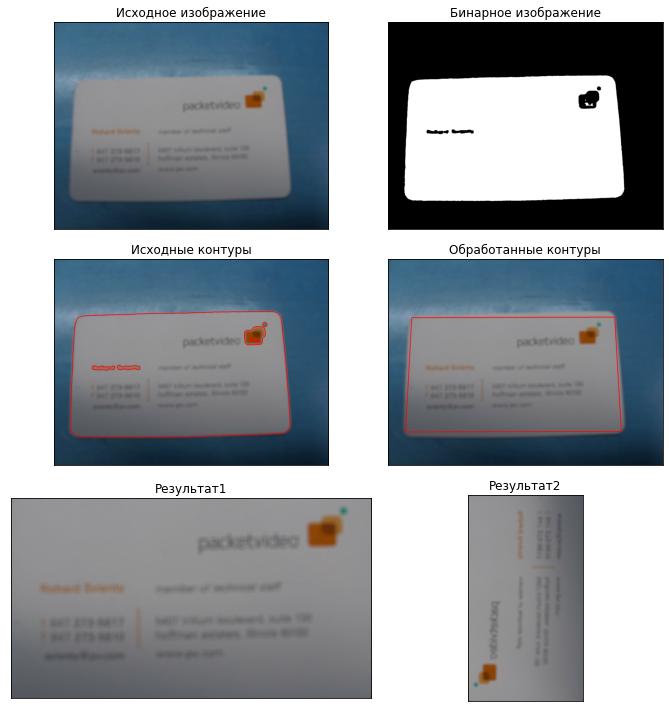

__________________________________________________________________________________


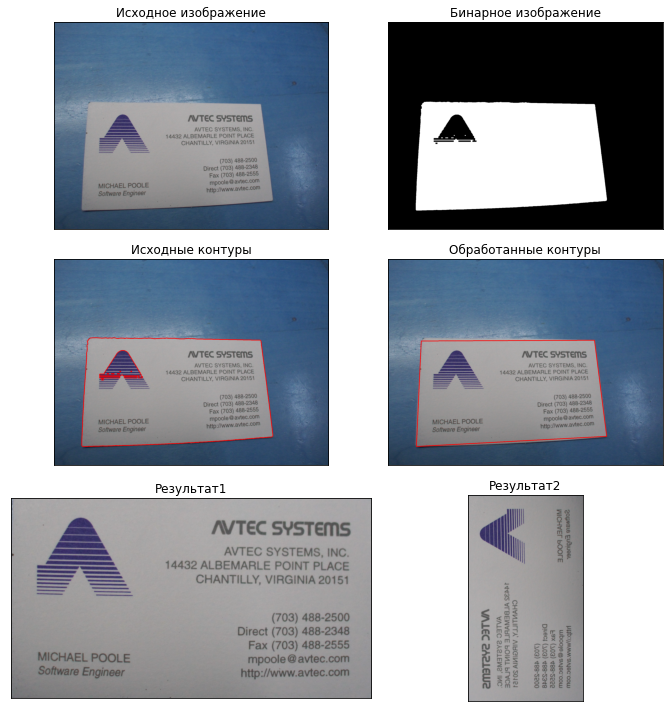

__________________________________________________________________________________


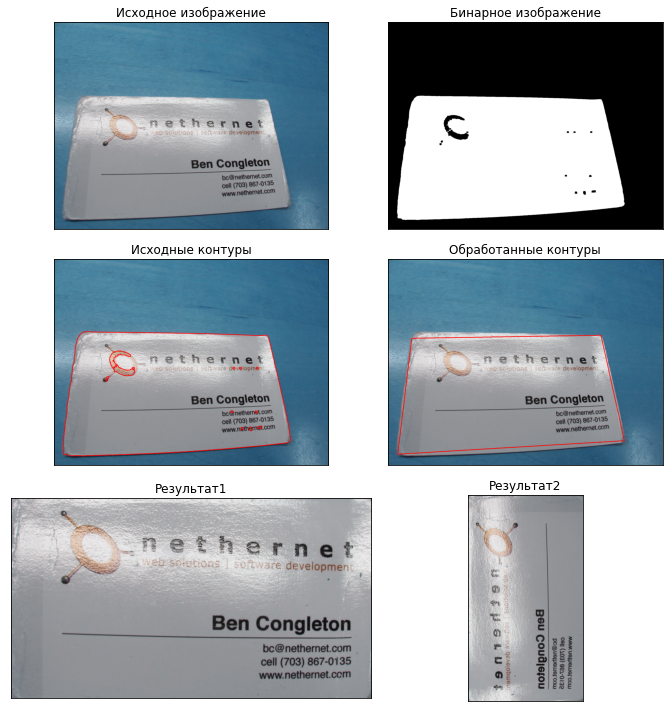

__________________________________________________________________________________


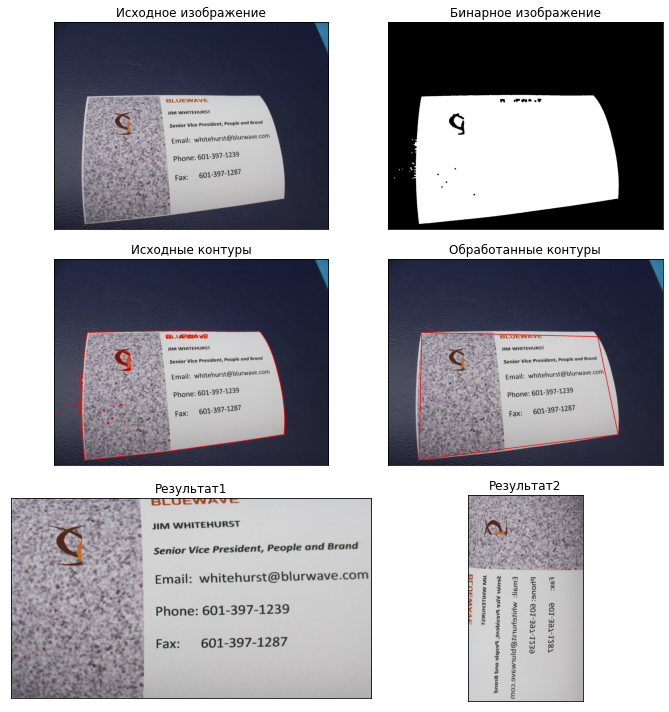

__________________________________________________________________________________


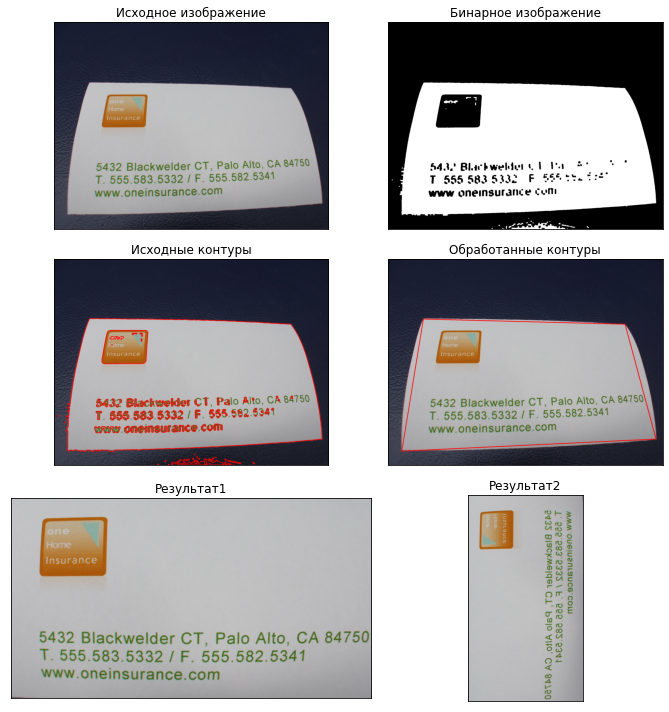

__________________________________________________________________________________


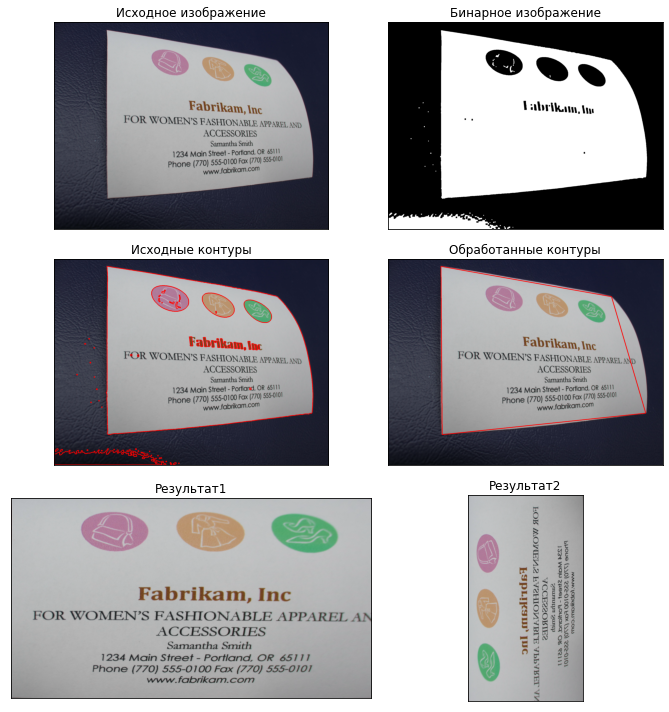

__________________________________________________________________________________


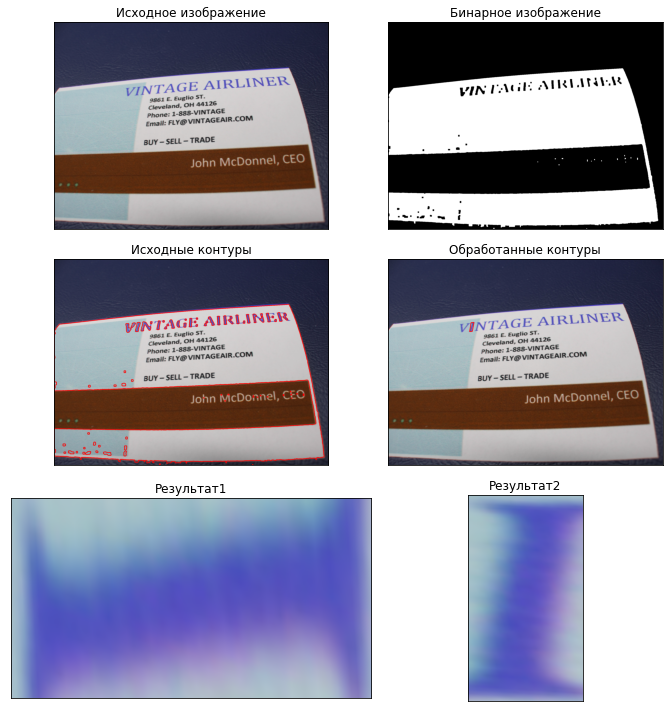

__________________________________________________________________________________


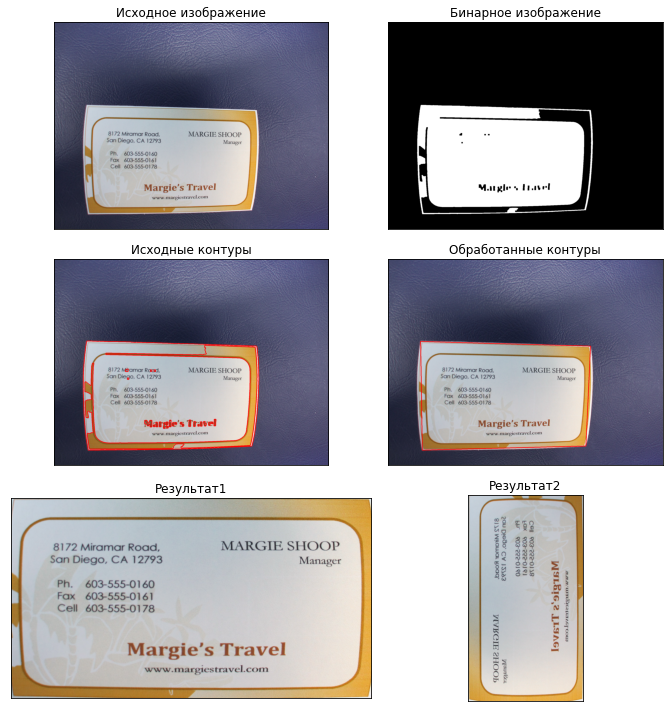

__________________________________________________________________________________


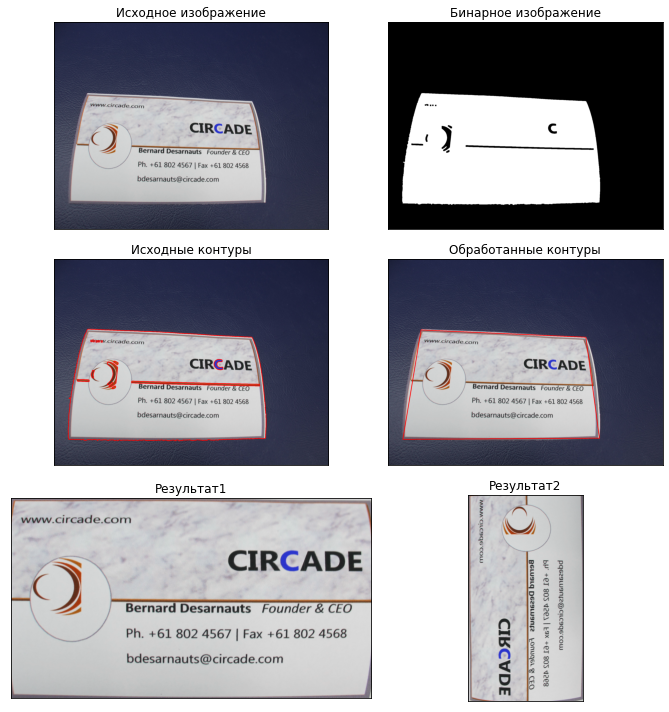

__________________________________________________________________________________


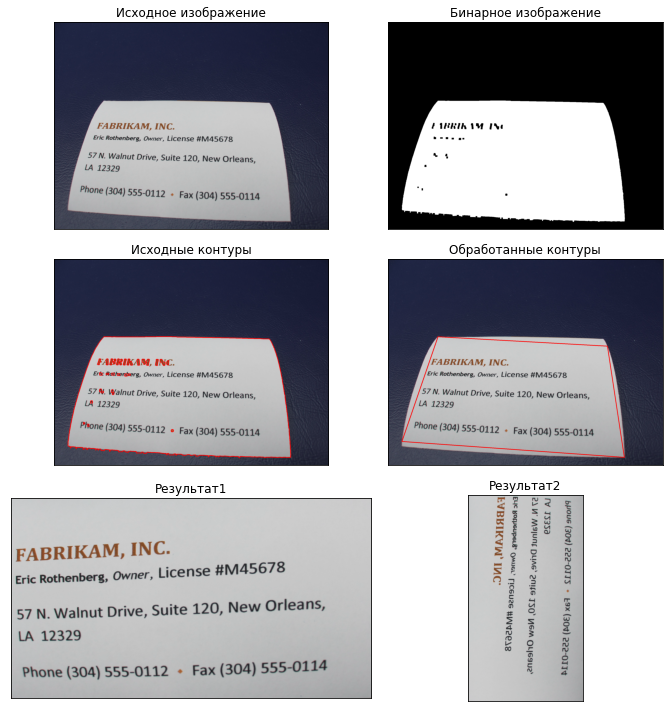

__________________________________________________________________________________


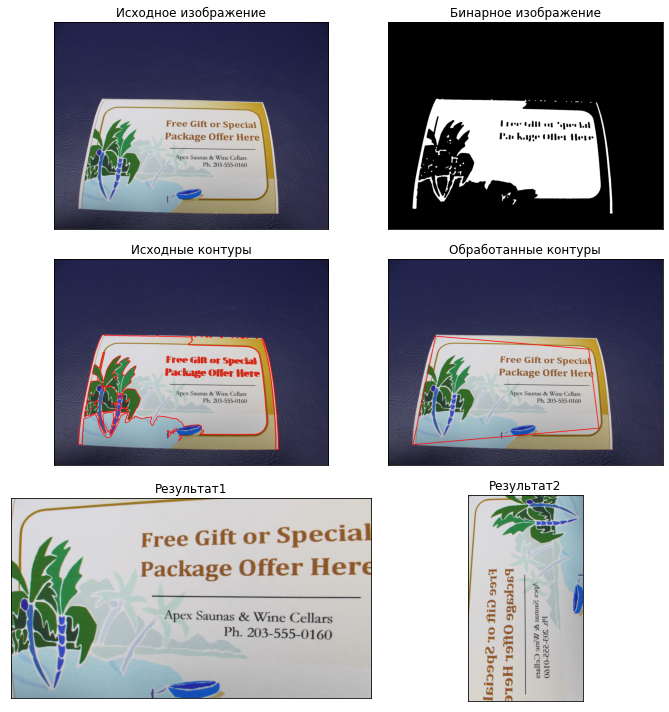

__________________________________________________________________________________


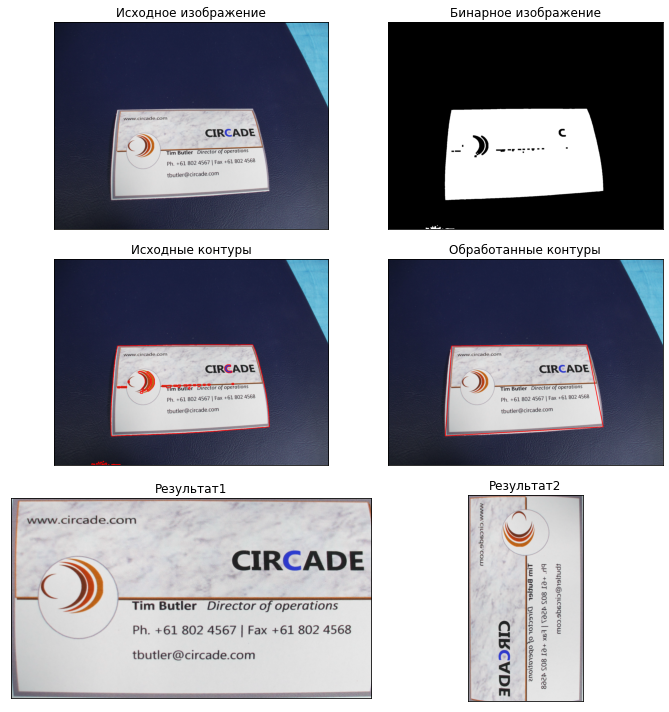

__________________________________________________________________________________


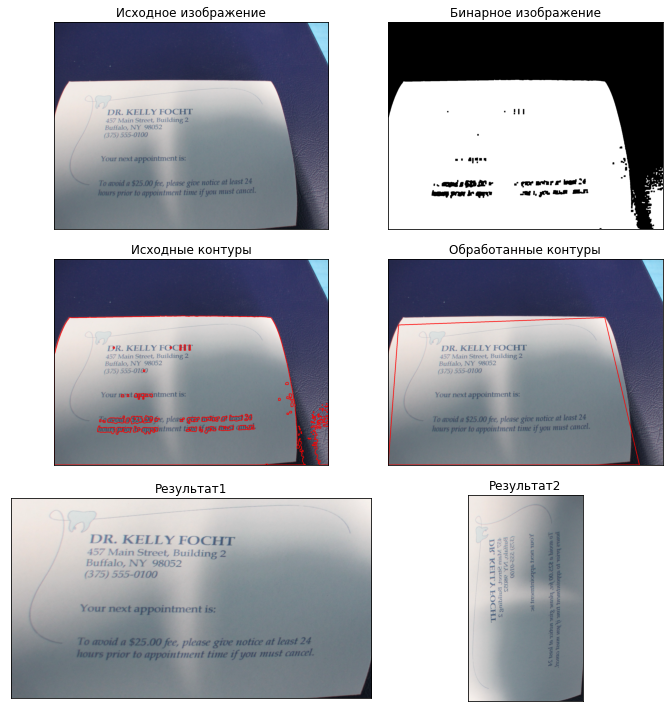

__________________________________________________________________________________


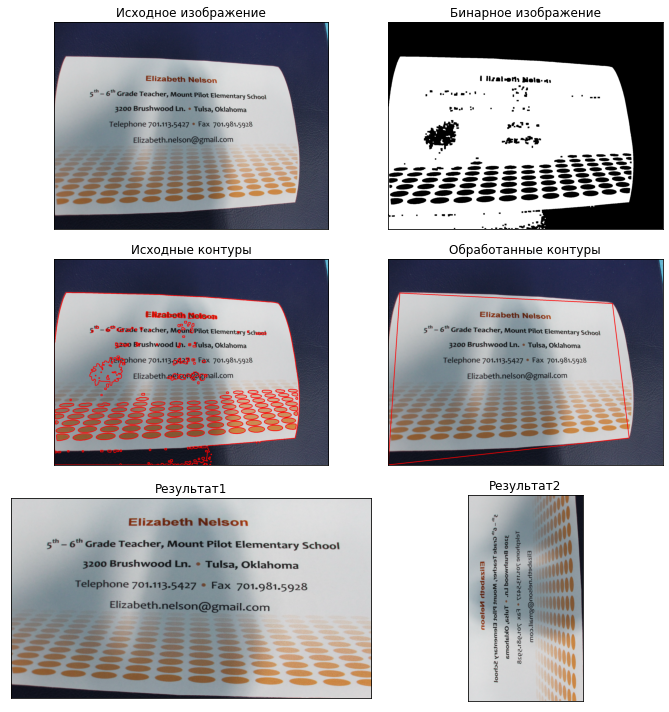

__________________________________________________________________________________


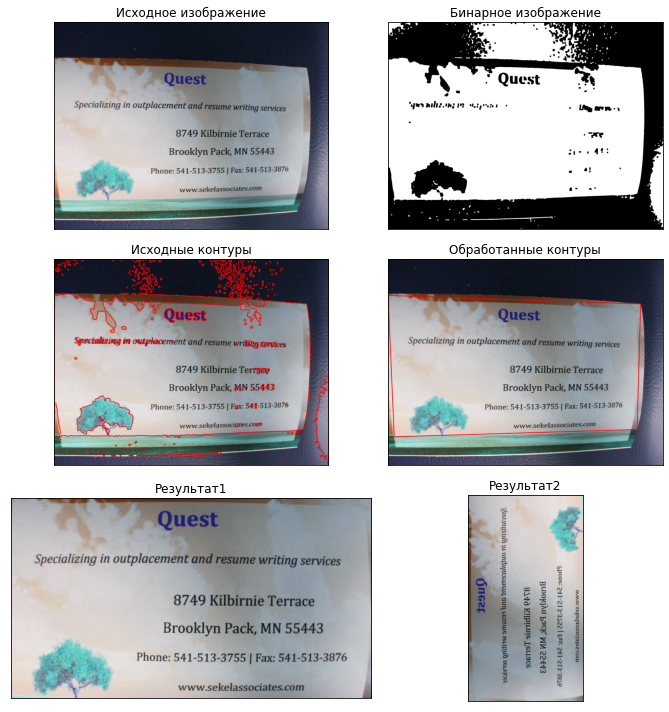

__________________________________________________________________________________


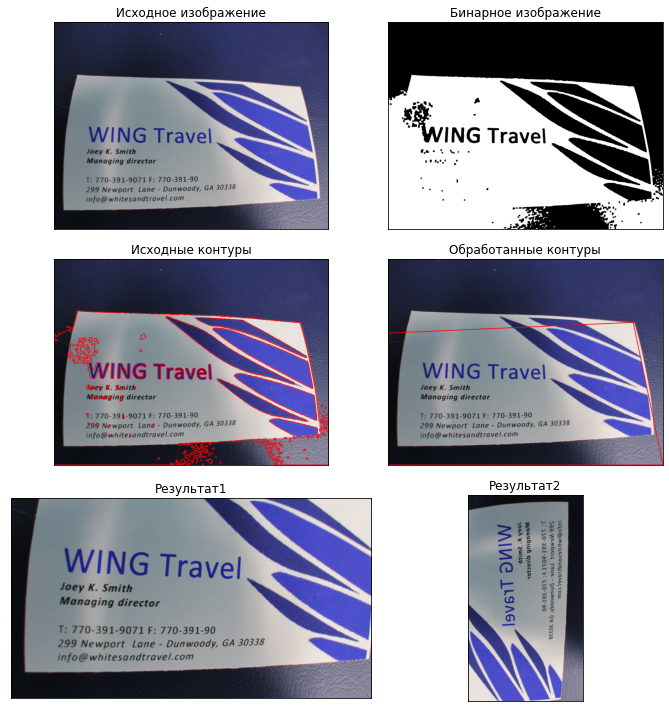

__________________________________________________________________________________


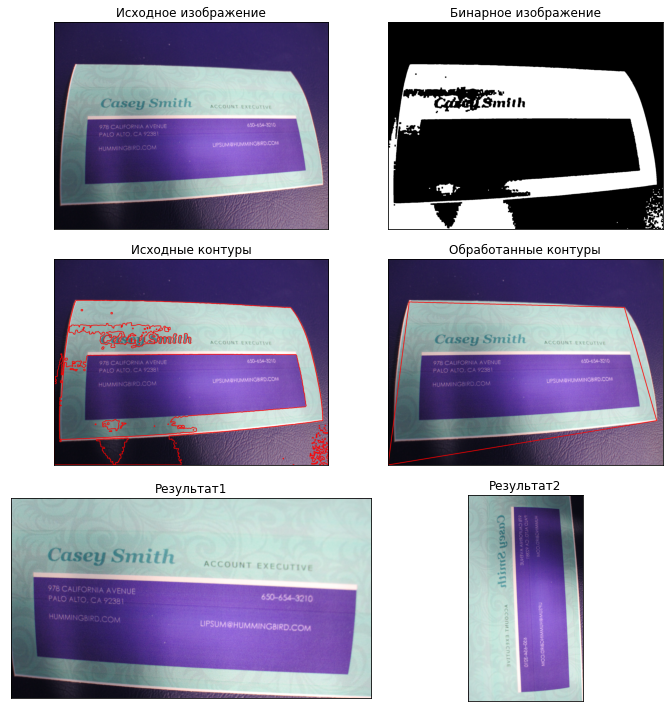

__________________________________________________________________________________


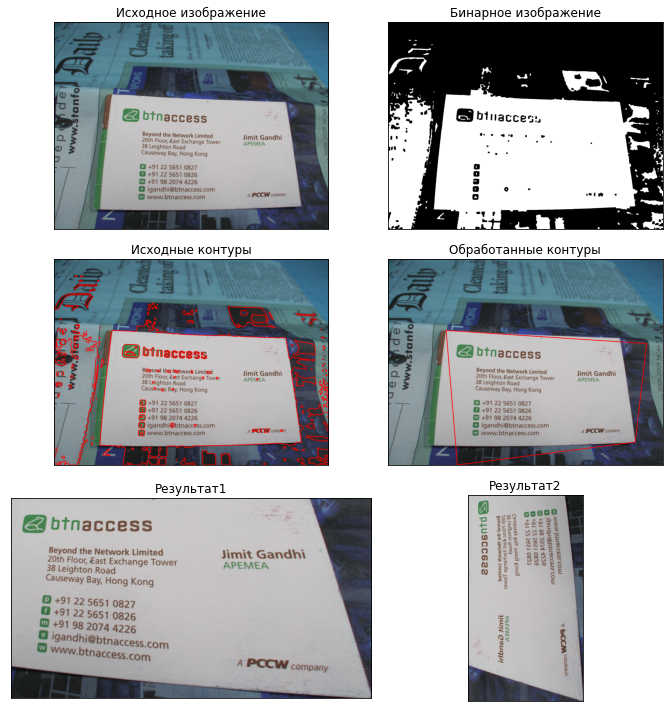

__________________________________________________________________________________


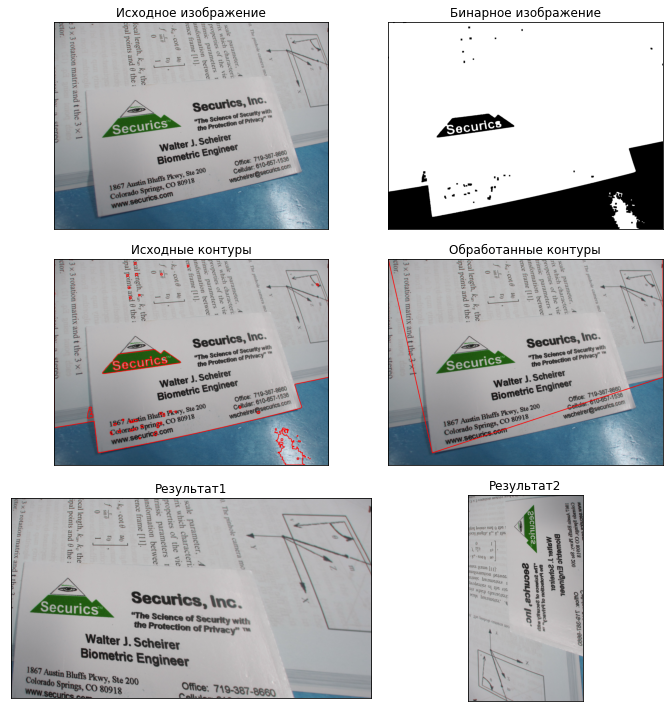

__________________________________________________________________________________


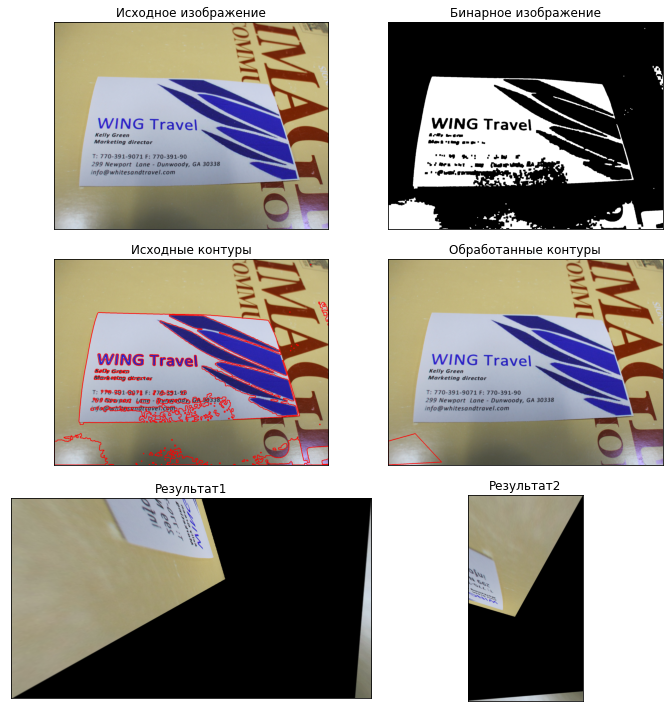

__________________________________________________________________________________


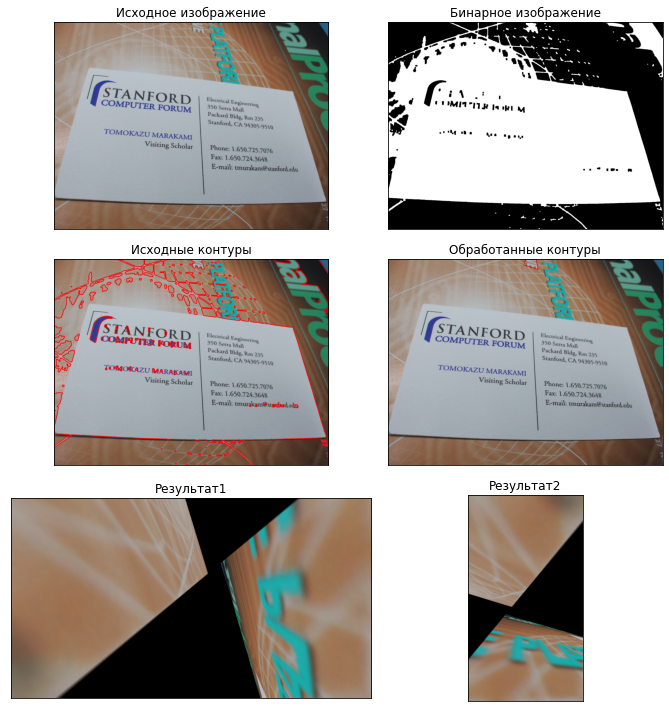

__________________________________________________________________________________


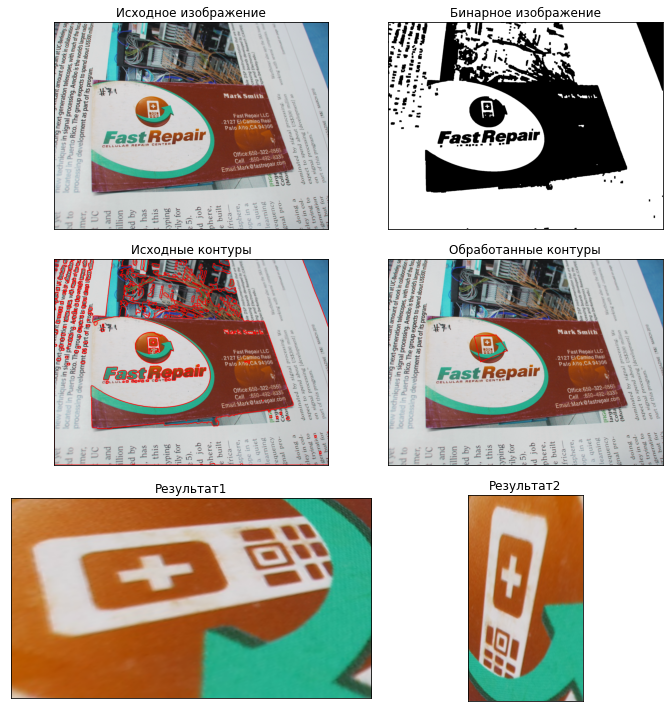

__________________________________________________________________________________


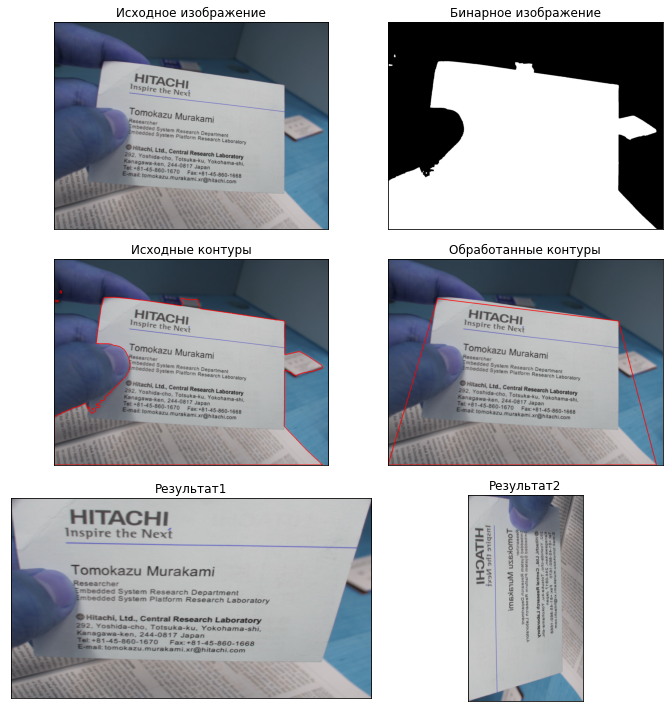

__________________________________________________________________________________


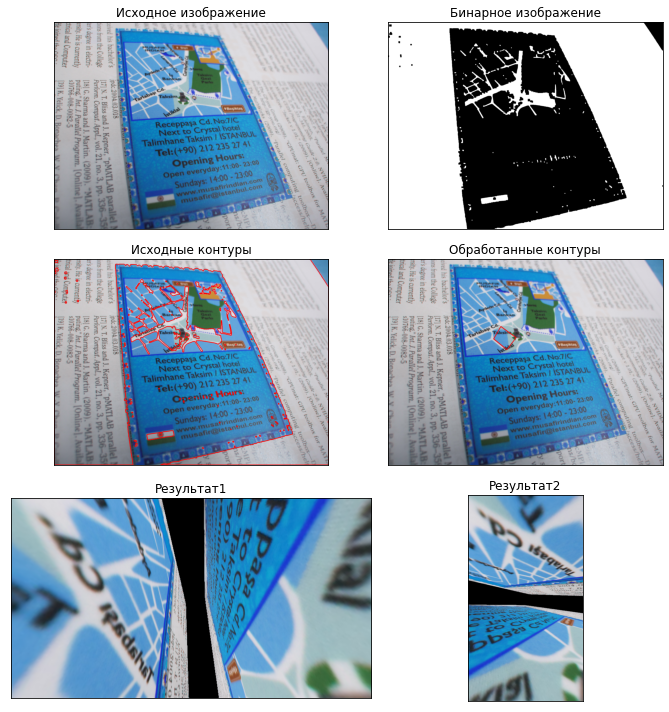

__________________________________________________________________________________


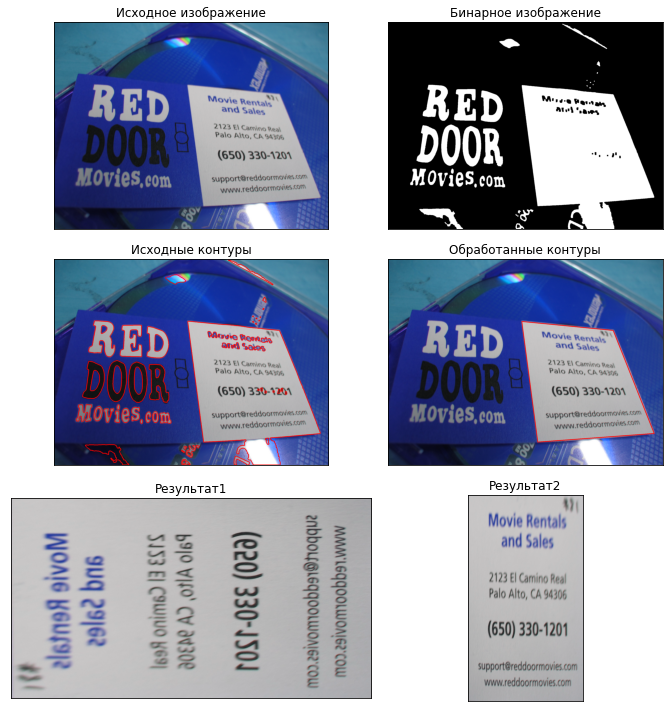

__________________________________________________________________________________


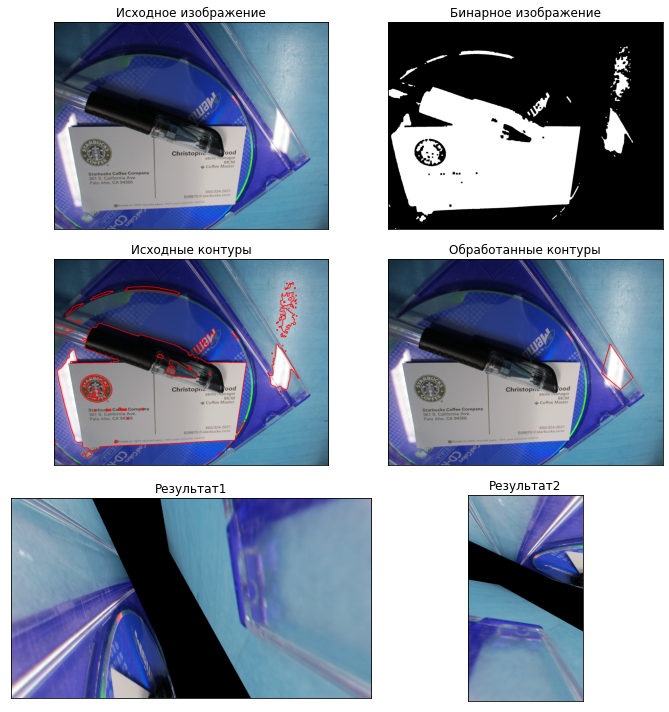

__________________________________________________________________________________


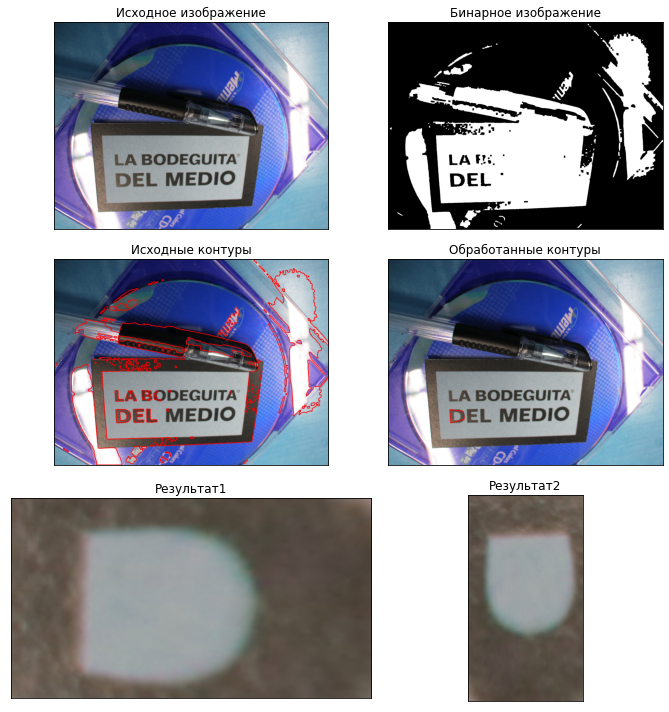

__________________________________________________________________________________


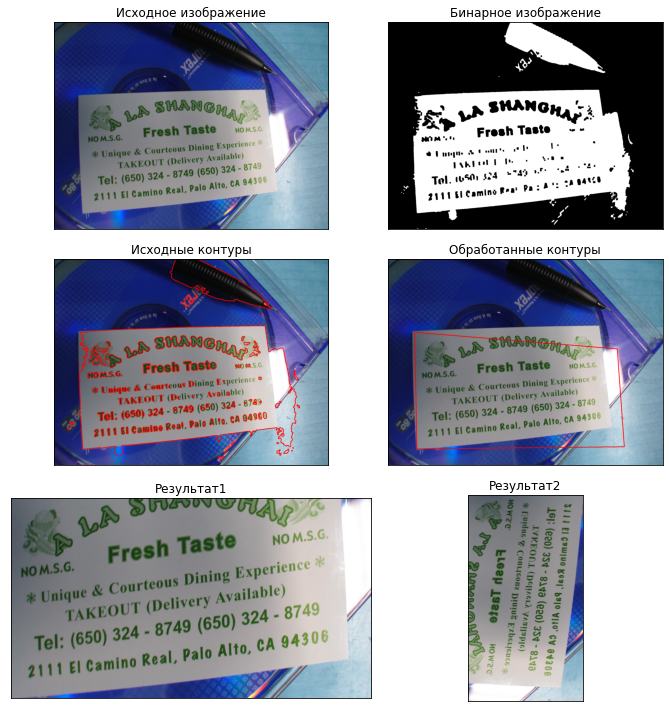

__________________________________________________________________________________


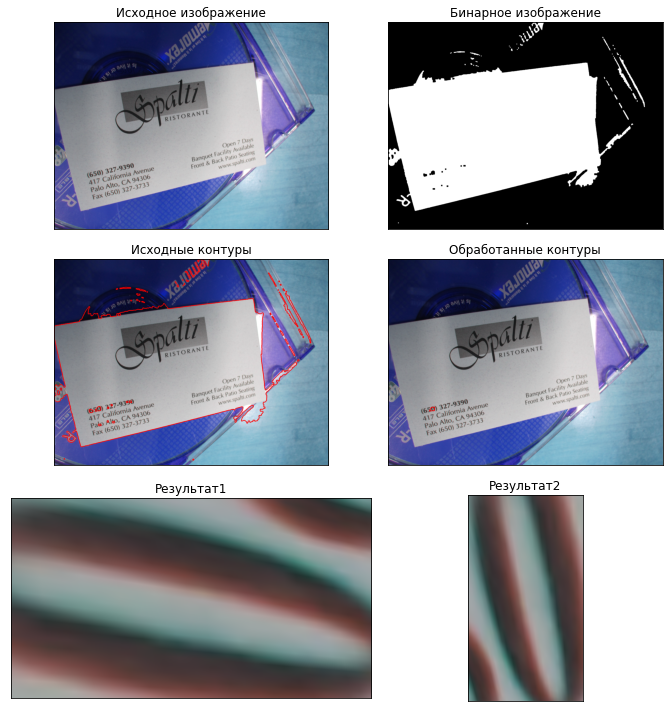

__________________________________________________________________________________


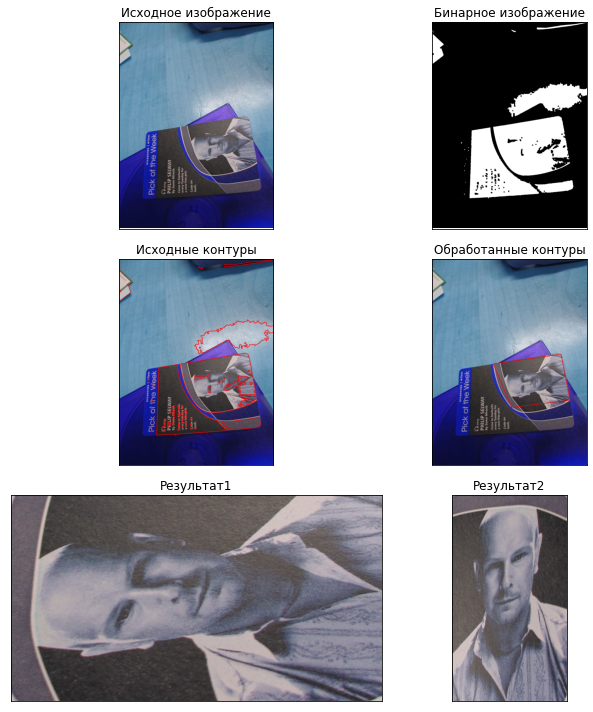

__________________________________________________________________________________


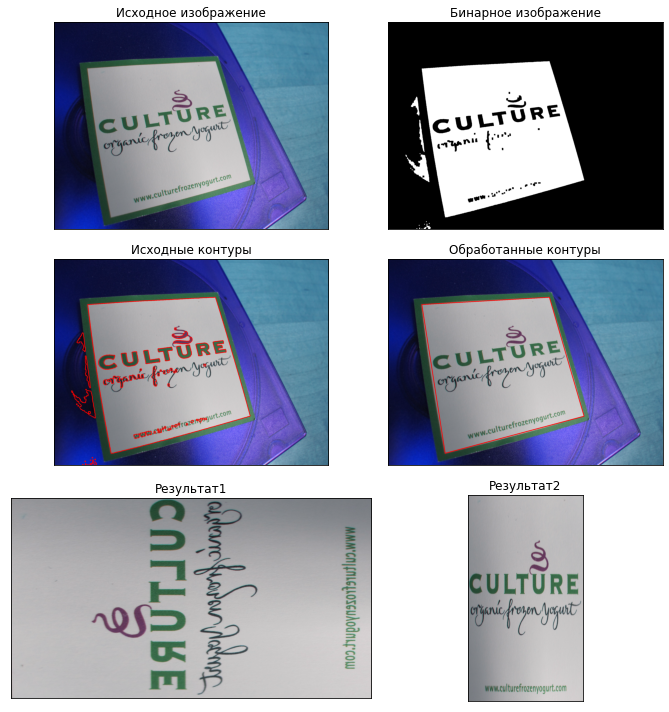

__________________________________________________________________________________


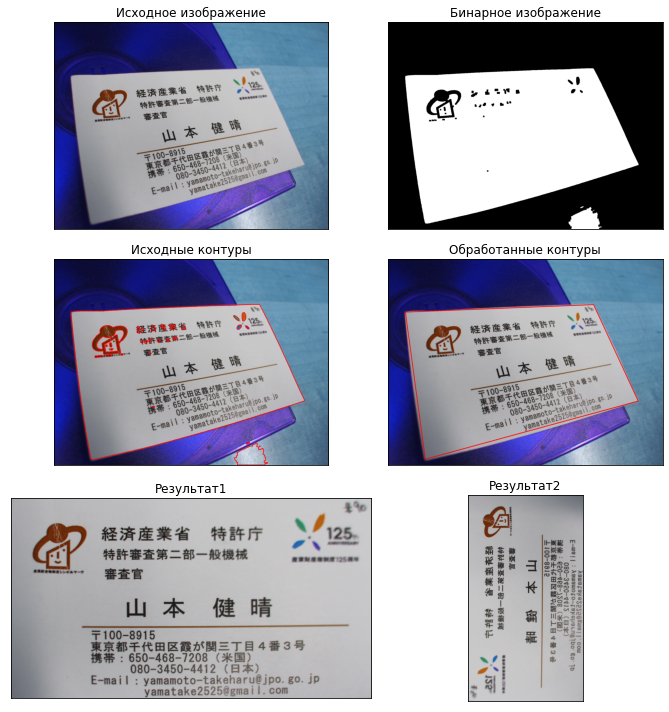

__________________________________________________________________________________


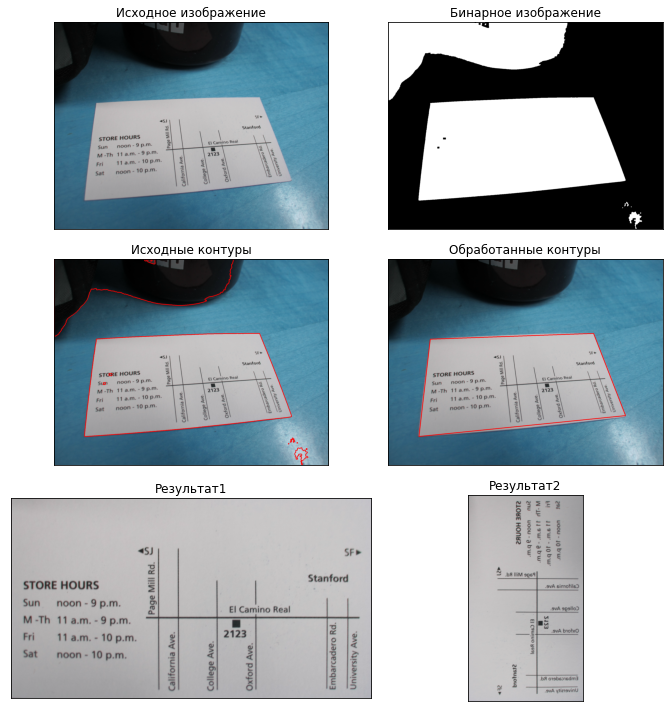

__________________________________________________________________________________


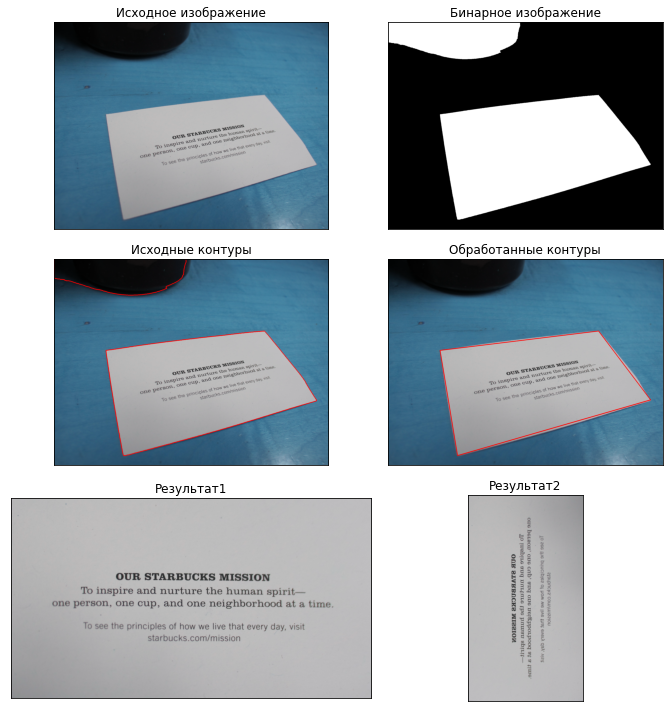

__________________________________________________________________________________


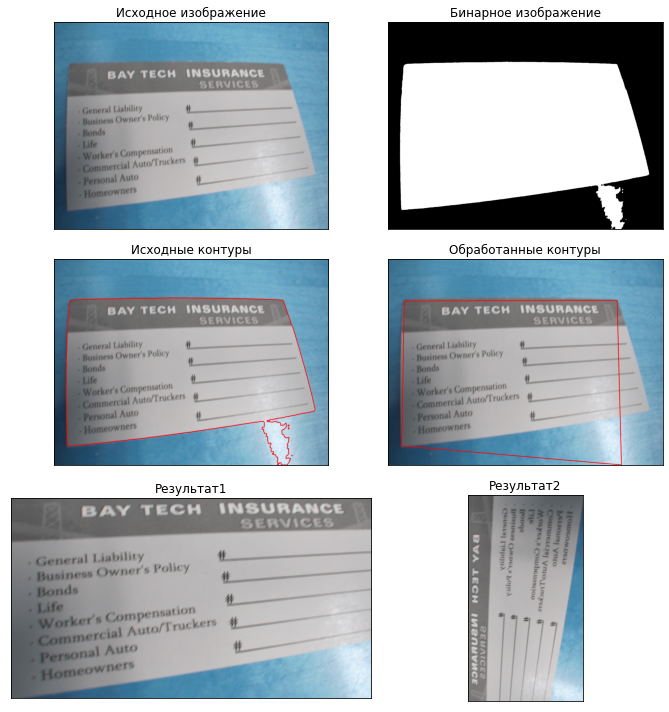

__________________________________________________________________________________


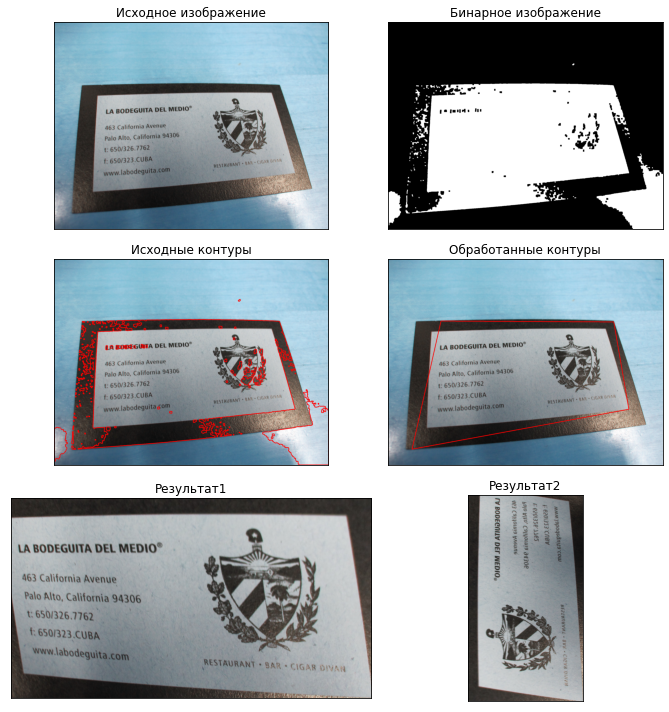

__________________________________________________________________________________


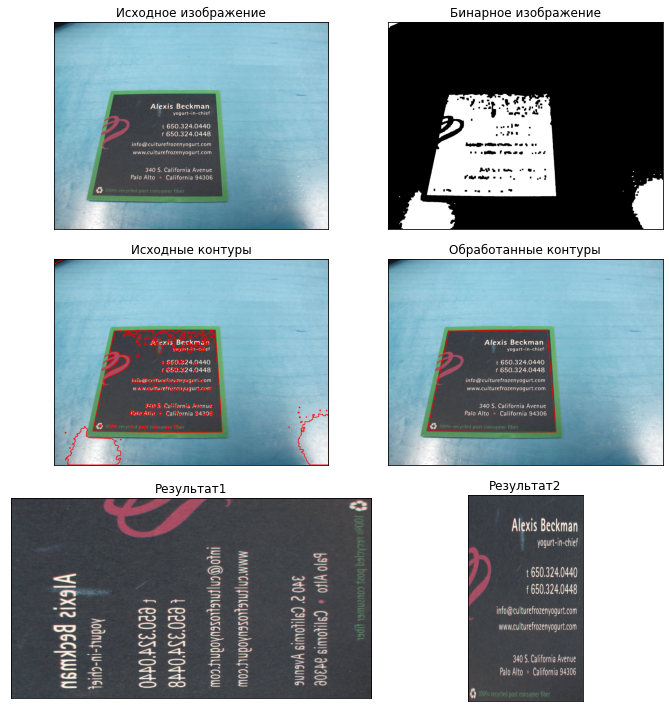

__________________________________________________________________________________


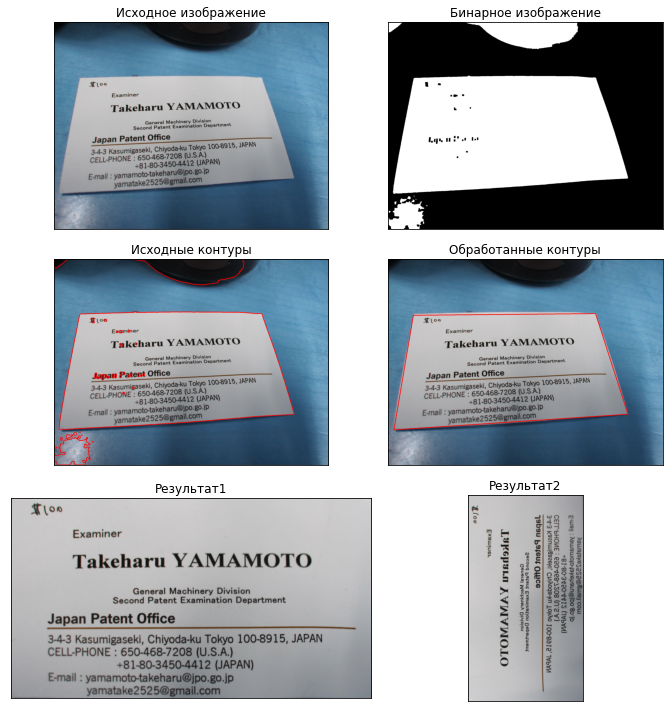

__________________________________________________________________________________


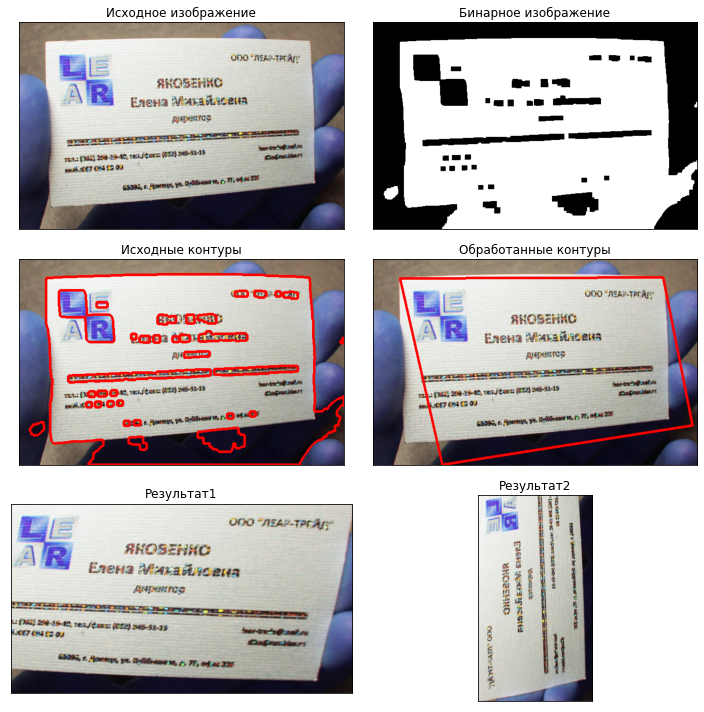

__________________________________________________________________________________


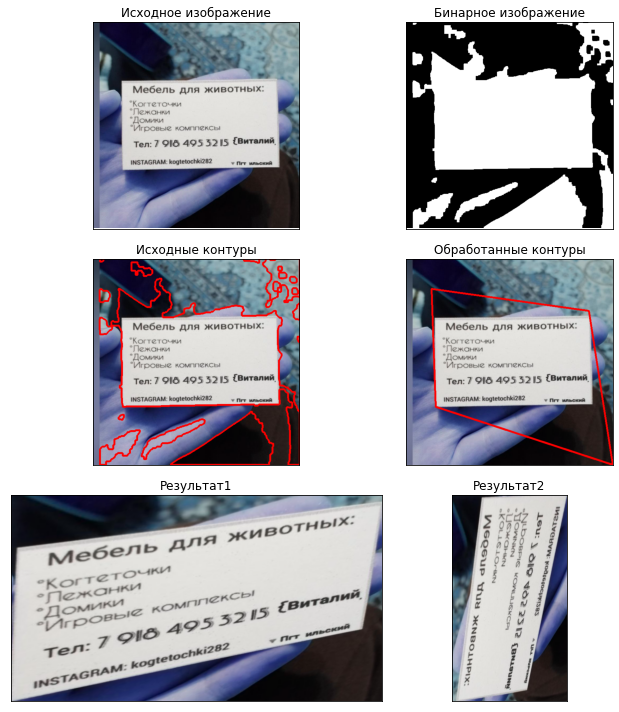

__________________________________________________________________________________


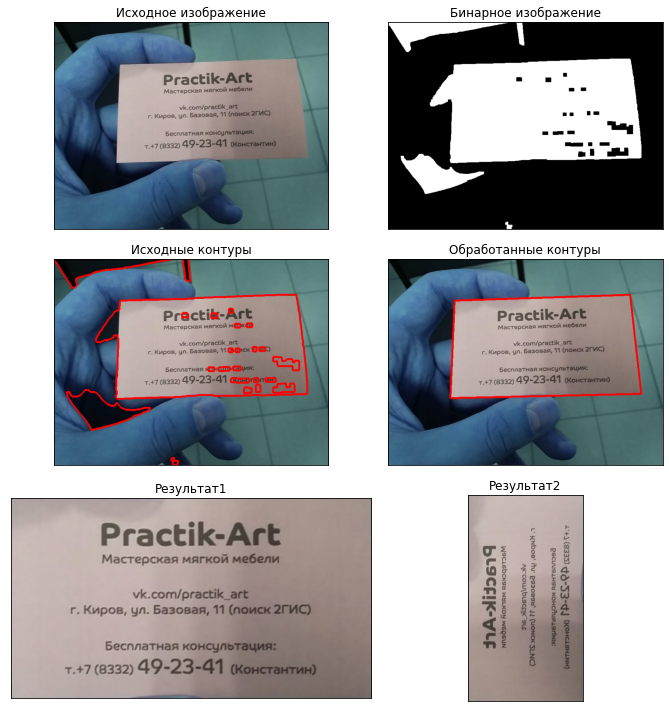

__________________________________________________________________________________


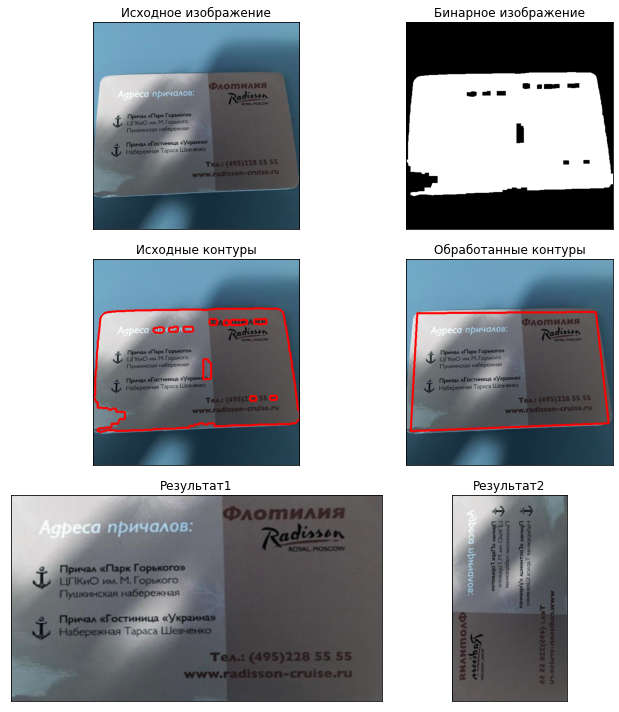

__________________________________________________________________________________


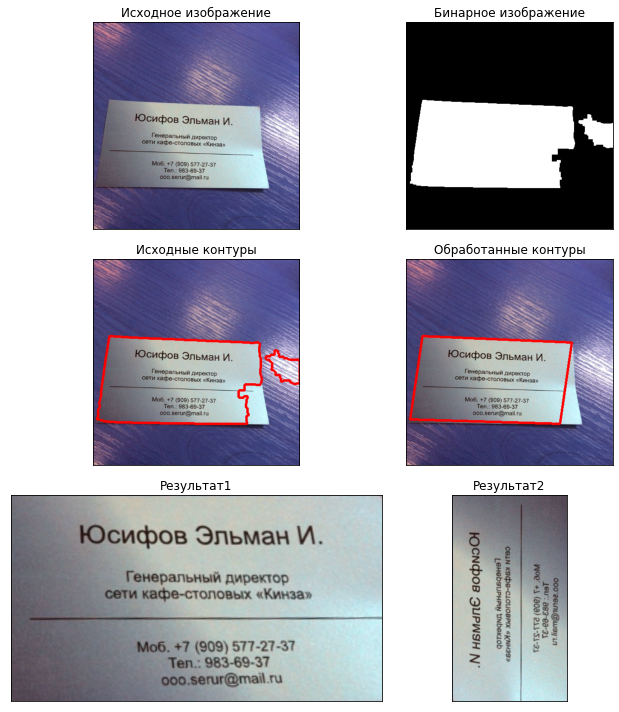

__________________________________________________________________________________


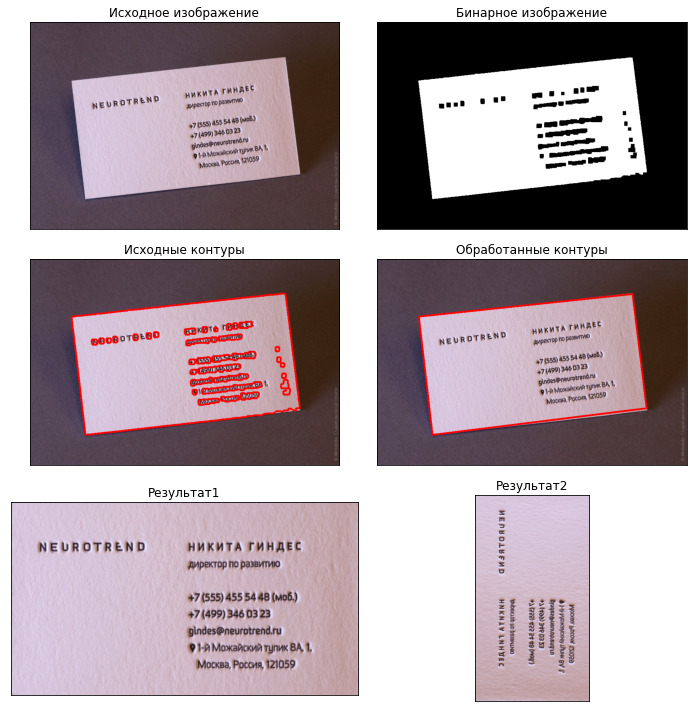

__________________________________________________________________________________


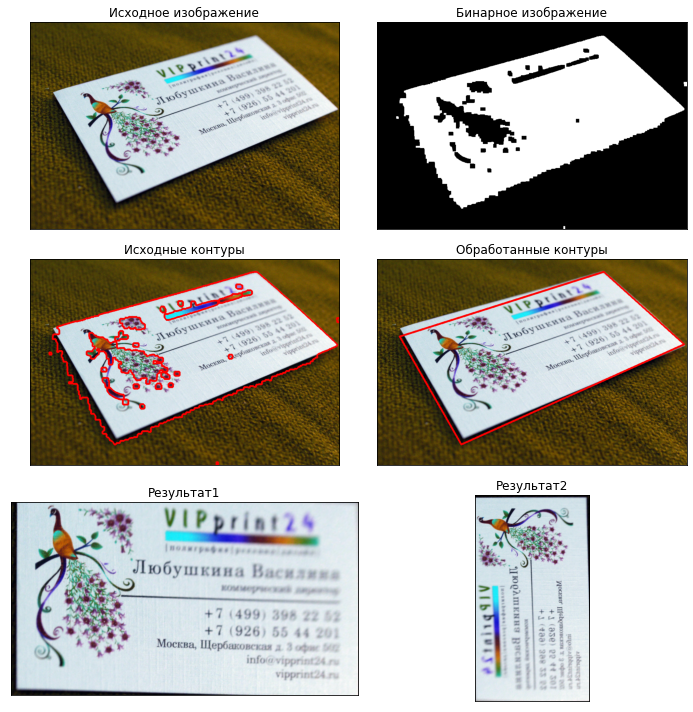

__________________________________________________________________________________


In [5]:
hsv_min = np.array((0, 42 + 3, 20 + 15), np.uint8)
hsv_max = np.array((190+50, 255 - 10, 253), np.uint8)
for fn in images[:]:
 
    ffn = directory + '/'+fn # имя файла, который будем анализировать
    img = cv.imread(ffn)

    if img.shape[0] > 1000:
        scale_percent=50
    else:
        scale_percent=70
    width = int(img.shape[1] * scale_percent / 100)
    height = int(img.shape[0] * scale_percent / 100)
    dsize = (width, height)
    output = cv.resize(img, dsize)
    #blur = cv.bilateralFilter(output,50,10,10)
    blur = output

    hsv = cv.cvtColor(blur, cv.COLOR_BGR2HSV) # меняем цветовую модель с BGR на HSV

    thresh4 = cv.inRange(hsv, hsv_min, hsv_max ) # применяем цветовой фильтр
    
    kernel = np.ones((5,5),np.uint8)
    thresh4 = cv.morphologyEx(thresh4, cv.MORPH_CLOSE, kernel, iterations = 1)
    thresh4 = cv.morphologyEx(thresh4, cv.MORPH_OPEN, kernel, iterations = 2)
    _,thresh4 = cv.threshold(thresh4, 0, 255, cv.THRESH_BINARY_INV)   

    contours, hierarchy = cv.findContours(thresh4.copy(), cv.RETR_TREE, cv.CHAIN_APPROX_SIMPLE)
    imageWithContours = cv.drawContours(output.copy(), contours, -1, (255, 0, 0), 3)
   
        
    businessCardContour = SearchOfCard(contours)
    if businessCardContour == None:
        continue
    
    imageWithBusinessContours = cv.drawContours(output.copy(), businessCardContour, -1, (255, 0, 0), 3)
    
    cnt = sortPoints(businessCardContour[0])
    #print(len(cnt),len(cnt[0]),len(cnt[1]))
    pts1 = np.float32(cnt[0])
    pts2 = np.float32([[0,0],[900,0],[0,500],[900, 500]])
    M = cv.getPerspectiveTransform(pts1, pts2)
    dst1 = cv.warpPerspective(output, M, (900,500))
    cv.imwrite(result + '\\' + fn[:-4] + 'Hor.png', dst1)
    
    pts1 = np.float32(cnt[1])
    pts2 = np.float32([[0,0],[500,0],[0,900],[500, 900]])
    M = cv.getPerspectiveTransform(pts1, pts2)
    dst2 = cv.warpPerspective(output, M, (500,900))
    cv.imwrite(result + '\\' + fn[:-4] + 'Vert.png', dst2)

#for show
    grid = [[output,'Исходное изображение'],
        [thresh4,'Бинарное изображение'],
        [imageWithContours,'Исходные контуры'],
        [imageWithBusinessContours,'Обработанные контуры'],
        [dst1,'Результат1'],
        [dst2,'Результат2']]

    fig, axs = plt.subplots(nrows=3, ncols=2, figsize=(10, 10,),
                        subplot_kw={'xticks': [], 'yticks': []})

    for ax,graf in zip(axs.flat, grid):
        ax.imshow(graf[0], interpolation=None, cmap='gray')
        ax.set_title(str(graf[1]))

    plt.tight_layout()
    plt.show()
    print('__________________________________________________________________________________')

In [6]:
directory = result
files = os.listdir(directory)
images = filter(lambda x: x.endswith('.png'), files)
images = list(images)

# Предобработка

In [7]:
def Deduct(image1, image2):
    imageShape = image1.shape
    result = np.zeros(imageShape, int)
    for i in range(imageShape[0]):
        for j in range(imageShape[1]):
            result[i, j] = int(image1[i, j]) - int(image2[i, j])
    return result    

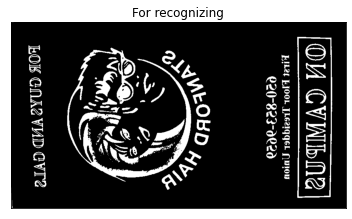

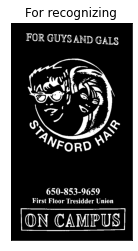

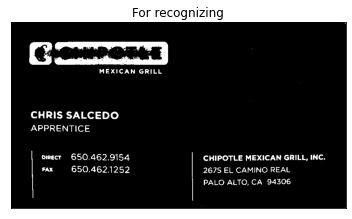

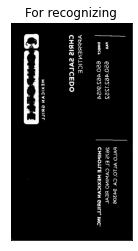

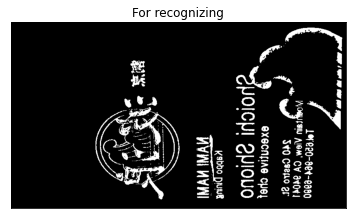

...

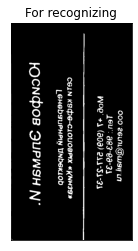

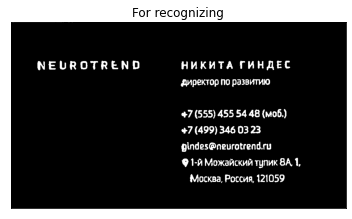

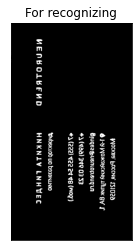

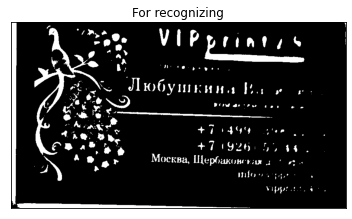

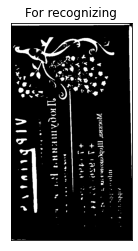

In [8]:
name = 'thresholded'
if not os.path.exists(name):
    os.mkdir(name)
writeDirectory = path + '\\' + name + '\\'

for fn in images:
    
    #Загружаем изображения
    ffn = directory + '/'+fn # имя файла, который будем анализировать
    img = cv.imread(ffn, 0)
    
    blured = cv.blur(img, (50, 50))
    deductedImage = Deduct(blured, img)
    cutedDeductedImage = deductedImage.copy()
    cutedDeductedImage[cutedDeductedImage < 0] = 0
    cutedDeductedImage[cutedDeductedImage > 255] = 0    
    ret, thresholdedImage = cv.threshold(cutedDeductedImage.astype(np.uint8), 0, 255, cv.THRESH_BINARY + cv.THRESH_OTSU)  
    plt.subplot()    
    plt.imshow(thresholdedImage, cmap = 'gray')    
    plt.title('For recognizing'), plt.xticks([]), plt.yticks([])      
    plt.show()        
    cv.imwrite(writeDirectory + fn, thresholdedImage)    

# Распознование

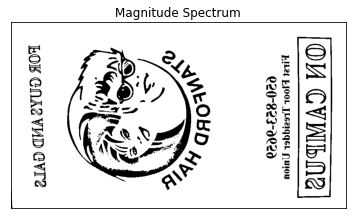

OU CVINbN2

BiLeg BJOOL [Leziqqe juiou

020-823-0020

 

LO’ GNA2VUD CvTe


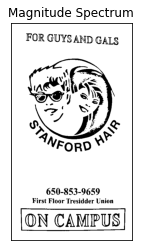

FOR GUYS AND GALS

 

650-853-9659

First Floor Tresidder Union

ON CAMPUS


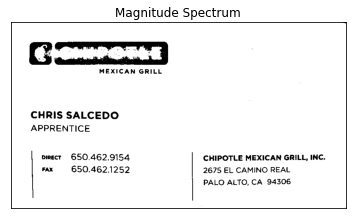

MEXICAN GRILL

CHRIS SALCEDO

APPRENTICE
omect 650.462.9154 CHIPOTLE MEXICAN GRILL, INC.
FAX 650.462.1252 2675 EL CAMINO REAL

PALO ALTO, CA 94306


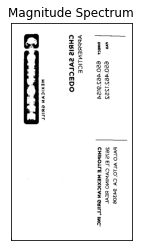

bvro viLo' Cv av20e

ex ero tes S25 sek2 EF CVWIMO BEVT
pwece CQO TES dION CHIbOLTE WEXICVK GBIF INC”
VbbBEULICE

CHBI2 2VrCEDO

WEXICYWM CBITT

G


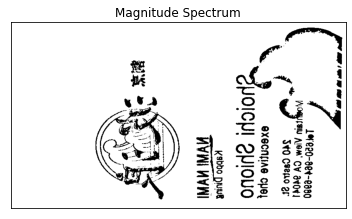

ae re “——
1 €20-8et-e980

NORFEIU AIOM' CY ayO¥]

. ff * S¢0 Ceeno ar
XY @XECNTIAG cLel
Buoropr gpiovo
Ksbd0 DRUa

VII MYA


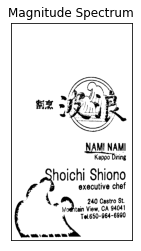

NAMI NAMI

Kappo Dining

executive chef

240 Castro St.
oi View, CA 94041
“ Tol650-964-6990
wae as th oe

oe Shiono


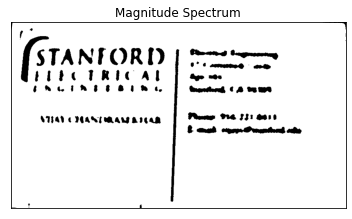

;

f

STANFORD
PLbc TRICALT

enatinsg t Gime,

ATAU CERN CAN CAR

Cet Segmenenny
0° 6 mene aot
age ts

trenton, ( 4 bE ENR

Prune 14 331 O018
0 ened cg Onion ote


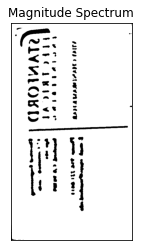

Foy mr qeeeet wy
OStCd CHEV LECNVICD aamem are tt eee

tlhe, etn» penpey «¢'e onme

‘whew
ZAVKLO’D ae


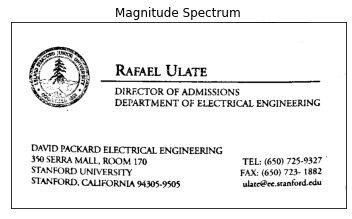

RAFAEL ULATE

DIRECTOR OF ADMISSIONS
DEPARTMENT OF ELECTRICAL ENGINEERING

 

 

DAVID PACKARD ELECTRICAL ENGINEERING .
350 SERRA MALL, ROOM 170 TEL: (650) 725-9327
STANFORD UNIVERSITY FAX: (650) 723- 1882
STANFORD, CALIFORNIA 94305-9505 ulate@ee.stanford.edu


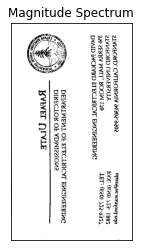

2IWVEOBD’ CYTIEOBUIY ot202-0202 NITCECE-eesUZOLG-eqn
2IVVEOBD NVIAEB2LLA EVX: (@20) A52- 1985
320 2EKBY WIT’ BOOW 10 LET (@20) 452-935) |
DVAID bYCKYBD ETECLBICYT EMCIMEEBING

DELVKELWEML Ob ETECLBICWI EACIVEEKING
DIBECLOK OF YDWIe2ione

KVEVEr ()IVLE


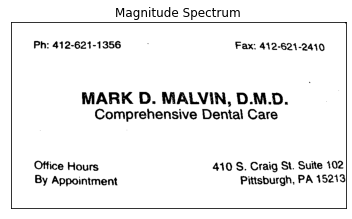

Ph: 412-621-1356 . Fax: 412-621-2410

MARK D. MALVIN, D.M.D.
Comprehensive Dental Care

Office Hours 410 S. Craig St. Suite 102
By Appointment Pittsburgh, PA 15213


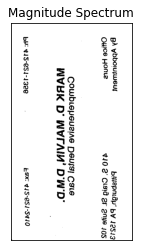

BA yobowsweuy bifepmay’ by 12519
ource Hone WO 2° Cisid ar enue jos

Cowb.epeveins Deus} Cagle
WVBK D' WYPAIW’ DW'D"

bb: ¥45-@54-132e : ESX! H15-OS1-SHIO


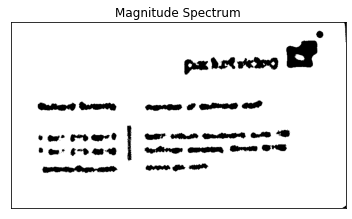

parctnna EF

ened Grane reren ¢ wteee at

+o ems net te? when Guaes ete *@
5S ow gD ae tetiong: ener, Gen GS

ete nent orees Ga aa


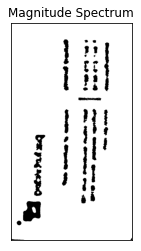

#08. Cob ng 26. HOw Ome Oe oy


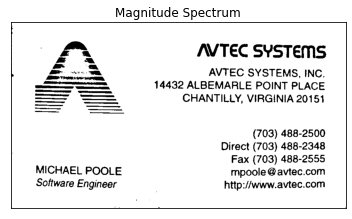

)

Mn,

\

yr?

:

i

MICHAEL POOLE
Software Engineer

AVTEC SYSTEMS

AVTEC SYSTEMS, INC.
14432 ALBEMARLE POINT PLACE

CHANTILLY, VIRGINIA 20151

(703) 488-2500

Direct (703) 488-2348
Fax (703) 488-2555
mpoole @ avtec.com

http:/Awww.avtec.com


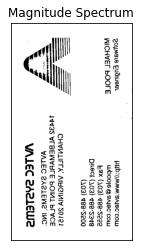

QOYNGIS EUTIUEEL
WICHVEr bOOrE

|"
ii

att!
“ty

¢

Pub:\\wmasarec cou
wboojé @ sAjec’cow
ESX (403) ¥88-See2
pitecs (\03) ¥88-S3¥e
(403) ¥88-S200

CHVULIFTA AIBGIUIV S012!
i8t35 VTBEWVETE bOIML brvCE
VALEC 2A2LEWe’ IMC’

VALEC eAeLeWe


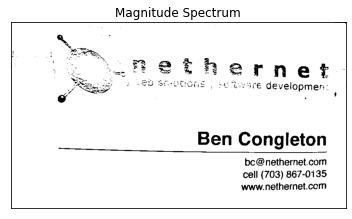

Rernet

Mons , sucbyare developmen:
: ,

Ben Congleton

 

bc@nethernet.com
cell (703) 867-0135
www.nethernet.com


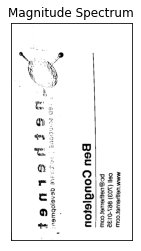

MMM UGIUGLUGICOLU
ceil (\03) 84-0192
Pc@uepewer cow

BEU Coud|efou

pis a.e QEASjODWEN:

wGLUGE


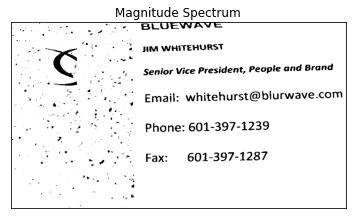

BLUEWAVE
JIM WHITEHURST

Senior Vice President, People and Brand

Email: whitehurst@blurwave.com
Phone: 601-397-1239

Fax: 601-397-1287


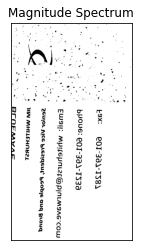

ESX: = ROT-30A-TS8\

bVOUVE: COT-30\-TS390

EWSII: MUHGEPNL2¢@ pjntmgae-cow
ZSUIOL AICS PLS2iqeuC Reobj>s aug BLaUG

TINE MHLLEHNBeL

BIrMnEAAVAEL


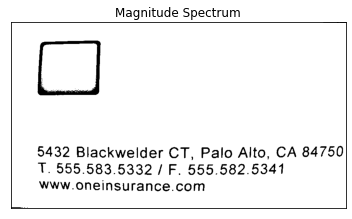

5432 Blackwelder CT, Palo Alto, CA 84750
T. 555.583.5332 / F. 555.582.5341
www.oneinsurance.com


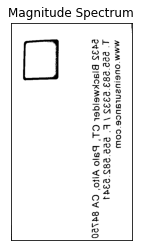

MMM OUGIVeNLSUCG COU
i 222 283 e335 \E 22e 285 234
Ot3S BISCKMEIGEL Cl’ bSIO YIfO’ Cy BY\20


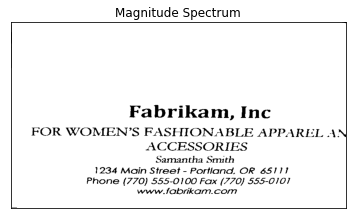

Fabrikam, Inc

FOR WOMEN’S FASHIONABLE APPAREL AN
ACCESSORIES

Samantha Smith
1234 Main Street - Portland, OR 65111
Phone (770) 555-0100 Fax (770) 555-0101
www. fabrikam.com


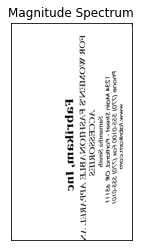

AMAL LODUKOLY COU
bKOUS (\A0) 222-0100 EX (AXO) 222-0101
JSSYT WAY ZHGS] - POLL OF Veh}
CSUSUTpS CUTE
YCCEeeOsu TES
LOB MOVIENM.2 EYVCHIOWYBLE VbbYBED TY

LSPLIKSUS pC


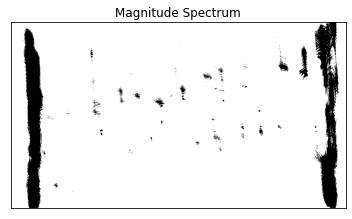

ata


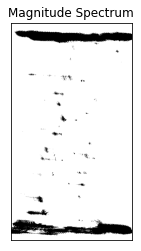

see ’ waa
ut " Sia
ny
m
ye -
a
t
%
* oy
Ativan hg Me
thi


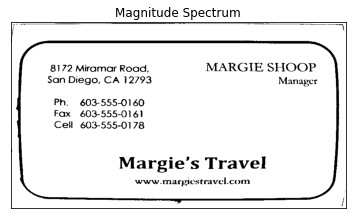

8172 Miramar Road, MARGIE SHOOP
San Diego, CA 12793 Manager

Ph. 603-555-0160
Fax 603-555-0161
Cell 603-555-0178

Margie’s Travel

www.margicstravel.com


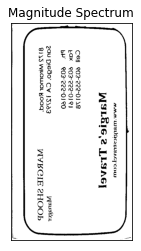

PRAM LS UBIGE ELS AGT COUT

WSL&EI6G 2 LLSAG]

CE POF 222-01 \8
EAX 903 222-0) 0)
bY’ e03 222-0120

2GU DISA" CV 1533 wausticr
BIAS WHaWal KOaq' WVBCIE 2HOOb


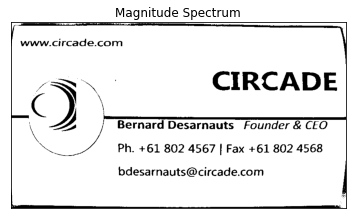

{ www.circade.com |

¢ *
\

Bernard Desarnauts Founder & CEO
NN Ph. +61 802 4567 | Fax +61 802 4568

bdesarnauts@circade.com |

Oo


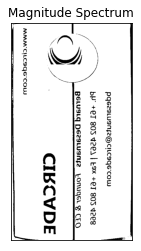

pqsesiugsnse@eucsqe'cow

be’ +@T 805 ¥2e\ | ESX +eT B05 ¥2e8

( =~ BGLUSLG DEZILUSNFZ2 LONUUGL F CEO
—€ 3} /
‘BY CIKCVDE

\ MMNVCILCSQG COU


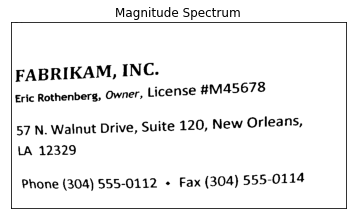

FABRIKAM, INC.

Eric Rothenberg, Owner, License #M45678

57 N. Walnut Drive, Suite 120, New Orleans,
LA 12329

Phone (304) 555-0112 + Fax (304) 555-0114


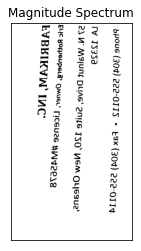

bvOUG (309) 222-OTTS + 9X (304) 222-0TTy

[VW I5350
2\ W MSIUNE DLIAG® ange TsO’ nem Olsague"

ELIC KOfpeUpEL?’ Qmuci? ficeues HINYPeEAg

EVBBIKVW INC:


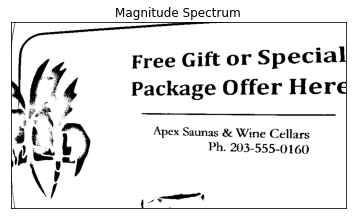

Free Gift or Special
[ V4 Package Offer Here

. 4 Apex Saunas & Wine Cellars
ati L Ph. 203-555-0160


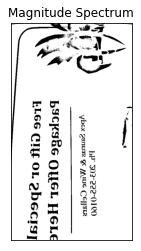

bP’ 502-222-0120
vyhex gsnuse ¢ YA\IUG CG]ISTA

bICKSEEG OLUGL HELE
LL6G Cll OL ebecigy]


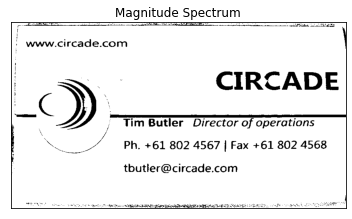

I
i

'
I
i

t

<D

;

sae

: www.circade.com

 

 

CIRCADE

Tim Butler Director of operations

Ph. +61 802 4567 | Fax +61 802 4568

tbutler@circade.com


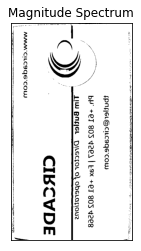

ER IE ee

oD

 

a“ \
\

~ f

MMM‘CILCSQG'COL

OI

 

fpNyEL@cicsqe'cow

bv’ +@T 805 t2e\ | E9X +eT 805 ¥2e8

LI BALIEL Hwecsor of obci.anove

 

CIBCVDE


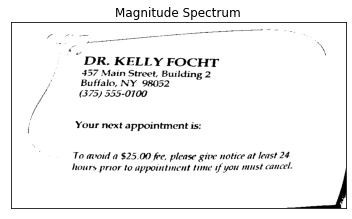

DR. KELLY FOCHT
457 Main Street, Building 2
Buffalo, NY 98052
(375) 335-0100

Your next appointment is:

To avoid a $25.00 fee, please give notice at least 24
hours prior to appointment time if you must cancel.


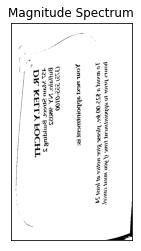

yom baron yo ubbourpncarg pane a Row warey COMCRY
LO BHO 4 B5279O WE hyGues Bie wopce ap wury 5g

Jom vex sbbompucys re:

(AL) 222-0100

BNUIIOC UA aed25

42\ WISE enG6r BATIGUB 5
_Dps KEIFPA LOCHL


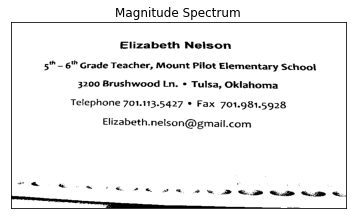

Elizabeth Nelson
5" — 6" Grade Teacher, Mount Pilot Elementary School
3200 Brushwood En. « Tulsa, Oklahoma
Telephone 701.113.5427 * Fax 701.981.5928

Elizabeth.nelson@gmail.com

i i ee ee ee

set


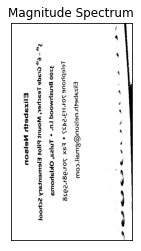

< « wo ee et a ee eR ee

E|ISSpesp-US{ZOV@Bwsglpcow
isjsbyous Somrss3-et5A e IX Aovaguv2dsg
3300 BLN2ZPMOOg [Ur e LA23* OKISVOWS
2a @,, CLSG6 LescpeL Wonus BHO EIGWuGuFSLA 2CcpoOoy

Ellsspermp Nej20u


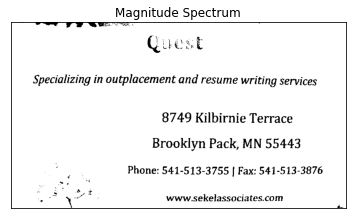

oe Fe

 

Specializing in outplacement and resume writing services

8749 Kilbirnie Terrace
Brooklyn Pack, MN 55443

Phone: 541-513-3755 | Fax: 541-513-3876

 

www.sekelassociates.com


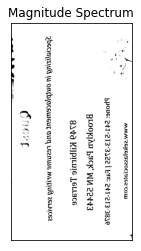

MAN 2EKG]S220CIS[Ge COW

 

pPOUG: QET-2T3-3A22 | SX: 2T-2T3-38e

BLOOKIAU HSCK WY 22443
BAtod KIHPILUIS LeLLgce

AHecigysiwd ws onghyaceweye aug Lezmuse MLICA zeLAICEe

ew ae a Ve Foe


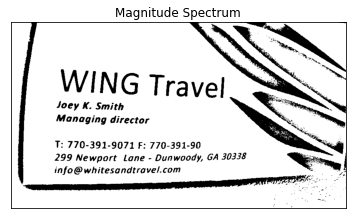

WING Travel

Joey K. Smith
Managing director

T: 770-391-9071 F: 770-391-90
299 Newport Lane - Dunwoody, GA 30338
info@whitesandtravel.com


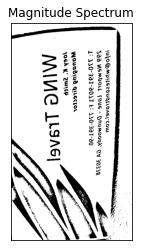

1W1LO © MPULSZQugtLaAGy cous
JIB WSMBOLE [AUG - HHUMOO|N EY 30339
1: \SO-30T-O0MT E: \N0-38T-30

WaVGAWA Quecior
yooh KTP

MING LESAeI”


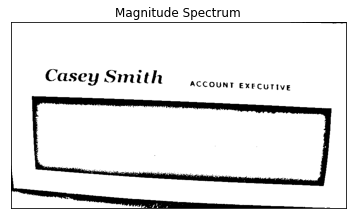

Casey Smith

ACCOUNT EXECUTIVE


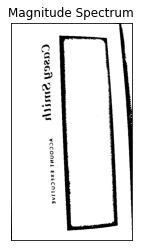

VCCONMWL EXECMIIAE

Cuech esses


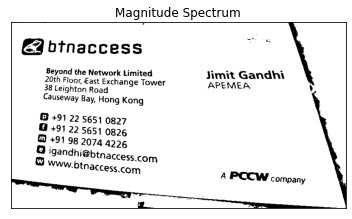

E@btnaccess

Beyond the Network Limited Jimit Gandhi
20th Floor, East Exchange Tower APEMEA

38 Leighton Road
Causeway Bay, Hong Kong

© +91 22 5651 0827

@ +9122 5651 0826

@ +91 98 2074 4226
igandhi@btnaccess.com

www.btnaccess.com APCCW company


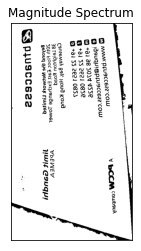

QO anmmppugscceze COW
asuqui@peUsccee? COW

@ +91 a8 SOA w5se

@ +91 55 202! ogse

@ tal 55 2e2! o85S\

Canzemga par Houa Koud
38 Telapsou BOS

Sosy Loot E9zt Excusude LOMEL
BSAOUG FS MELMOLK PILUIEEG

Gi pyusccs2e2

VY 6bCCM cowbsuA

VbEWEV
ywit GIUGPI


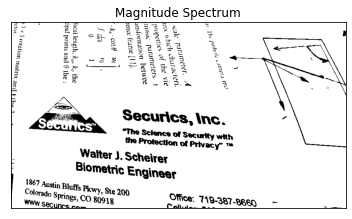

Securics, \nc.

“The Science of Sec with
the Protection of Privary-

Walter J. Scheirery
Biometric Engineer

Office. 7 \9-387-BaeQ  —

oahu.


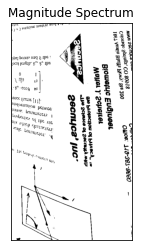

coh
gy x 7 WO(SOY mw

pix Sq ERS SO” rhe

betoic?
2. WWW

8 ALIS:

jeuh C281

 

 

3
Bes
cibs] borure Sug 0) IPS | 3 =
ors) joubip’ ™ ¥ IpS a g
zB "8
0 I Cy g
Vow Pp 3 e 23
CE corg no 5 = $s
7
1SUCE [Lge tn} 0 5% 9 ™m s
WelouNT oy Petey ® =~
tira, Urstuecery 8 & 2
MObeLneD a1 5
tu PLIES ay =
ray “UstIe(sup 5 & & Qf
‘ vit epey: . % ys 5:
N .
*
Mey = He 5
Mie ‘
Pty, Be g
ai G

0288-


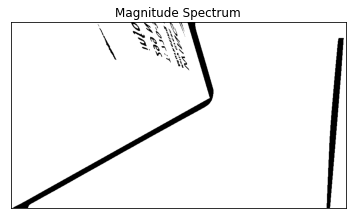

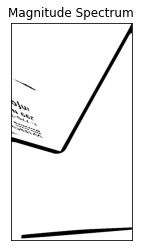

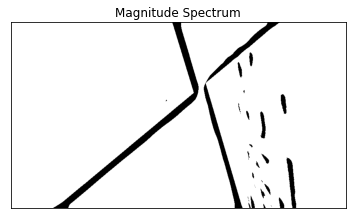

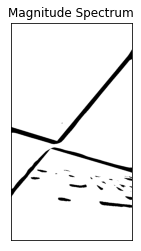

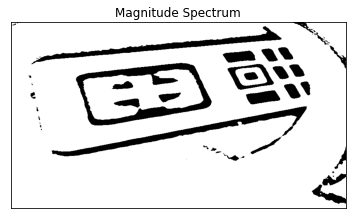

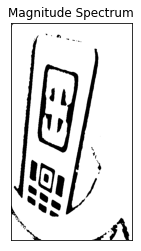

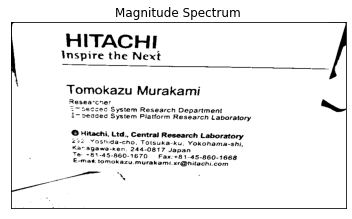

HITACHI

Inspire the Next

Tomokazu Murakami

Resea‘cner

  

peccec System Research Department
~ veasec System Platform Research Laboratory

@ Hitachi, Ltd., Central Research Laboratory
£22 Yoshida-cho, Totsuka-ku, Yokohama-shi,
Kanagawa-ken. 244-0817 Japan
Te: +81-45-860-1670  Fax:+81-45-860-1668
. E-mad: tomokazu.murak

ami.xr@hitachi.com
ao ‘


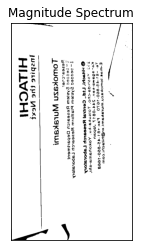

ee y

: E-woe PoWOKEST WNLsKSWEGuscpr cow
16: +G1-¥2-8EO-JEAO = ESX+B1-W2-BeO-1ees
Ko. 90aMS-KSU' S¥t-O814 ISDSU
S28 AO2VIQS-CHO’ LOI2NKS-KN AOKOPSUS-2pt

GE HuscpY P44" CELLS] WesesLcp PSPOLSTOLA

£96006G QAZIEW HISHOL WEZESLCH FAPOLIIOD
eccec DAzISW KEZ69LC) DEbIIWEYLT

BS2E9.CVEL

LOWOKSSA WOLsKSW

pu2bi.e (pe Yexy

HILVCHI


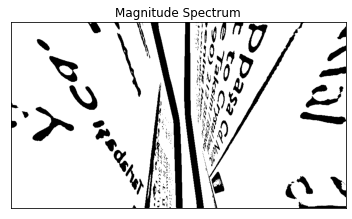

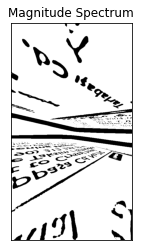

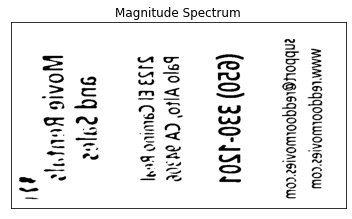

MMM'LEGqOOLWOAIG2 COW
anbbou@reqqoonwoniee cow

(020) 330-1504

b910 VItO' CH atI0e
5153 E| CWO Bes]

JUG Otc
NOAIG Jou ye
d)!


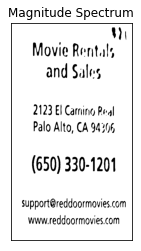

4)
Movie Rentals

and Sales

2123 El Carning Real
Palo Alto, CA 94306

(650) 330-1201

support@reddoormovies.com
www.reddoormovies.com


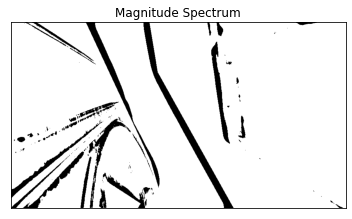

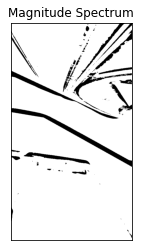

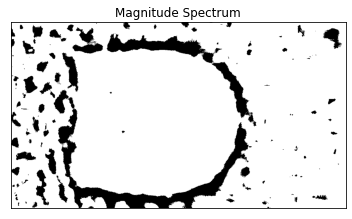

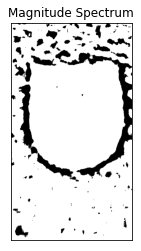

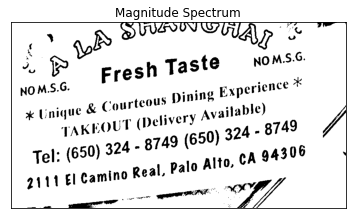

Fresh “s qaste NOMS.6.

NOM.S.G.

x Unique & Courteous pining Experience *K
TAKE ouT (Delivery Available)

- 8749 (6


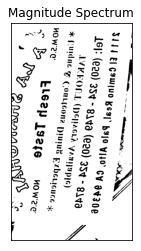

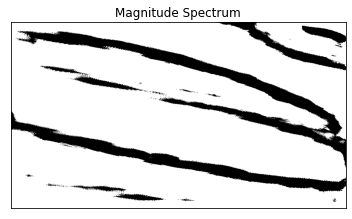

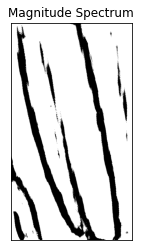

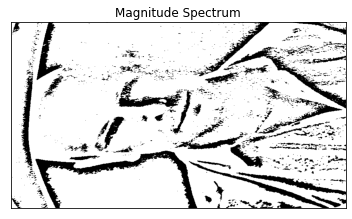

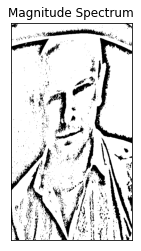

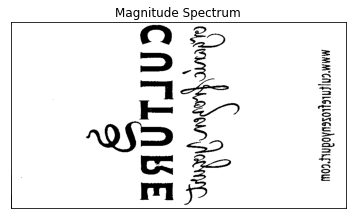

MMM'CH|EMLGLLOoSeUAOdALy COW

Dene haor lan
CNTLABE

2


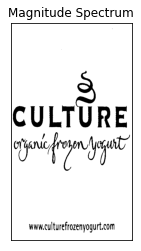

CU trite

www.culturefrozenyogurt.com


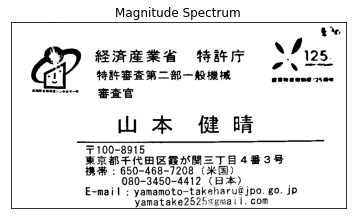

7 te

Denese eee S415,
CY SESS ene

ammewenny cee = = Ee

Wi A Oe Ba

T 915
RRSTKERRAMBH=TE4E3S
PR . 650-468-7208 (KE)
080-3450-4412 (HAR) ;
E-mail ; yamamoto-taksharu@jpo. go. Jp
yamatake2525@gmail. com


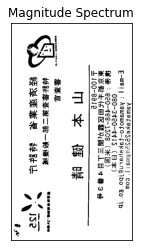

ASWSFOKESPSEeRiug | | cow
F-Ws!{ : ASWEWOLO-FSsKeysKNG1bO Bo Tb
080-3420-WIS (Ay)
RES > CPO-Te8-1508 (KE)
BERL RREMWWSE Le ts38
+ 100-8812

Tl & 8 8

wea EE
HEREERI Ra
SRE RL V2

 

Bansane see


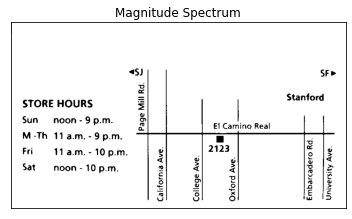

“J SFm

x3
a
=
o
a
a
a

STORE HOURS Stanford

Sun noon - 9 p.m. El Camino Real

 

M-Th 11 a.m. -9 p.m. z= >
Fri 11 a.m. - 10 p.m. ¢ 2123 z |g
< g ¢ 5 1¢
Sat. noon - 10 p.m. s 4 Z 3 2
e wu ¥
g} 8} § 3 |g
Ss & 6 & 15


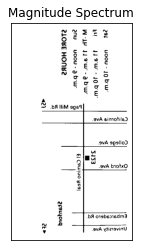

at voou - 49 bu

-avA apallod
3vA biotxO

      

      

-avA simotil6>

beh du uw - JQ bw
W-ip ly gw-abur
anu =yoou- 3g bur
2LOBE HONBS

.9vA ytizvavinU

  

.bA orsbex16dm3

       

E] CSWINO Keg]

2esuyoug

-bA IliM 9969

2) 2ke


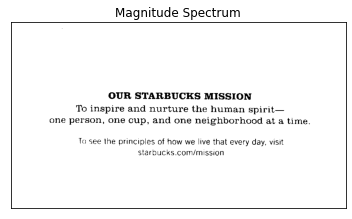

OUR STARBUCKS MISSION
To inspire and nurture the human spirit—
one person, one cup, and one neighborhood at a time.

To see the principles of how we live that every day, visit
starbucks.com/mission


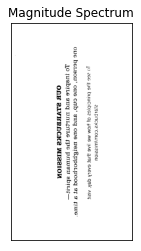

e{StpncKe COW \Wie2iou
10 266 JUG DUUCID|G2 Of YOM MG IAG [US GAGLA GSA’ Aleit

oue be.eou’ ous cob’ suq ove verRppoLpoog sf g FIWE"
Lo tebiLe suq usLenie spe pos abriyp—

ON @LVHBNCKe Wie2Ion


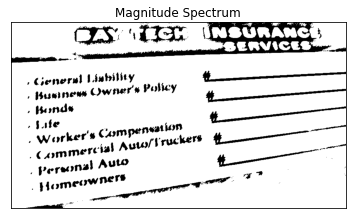

» General Liability
, Busnes Owner's Policy ————

» Bands nl
» sate

neation ‘

—_—

» Worker's Compe
¢ jommercial Avww/ truckers #
‘ personal Auto

: Homeawnel® ¢——

ee


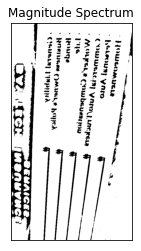

ee a

HOwomuege tn.
“beteoun, yaro ee
“¢ OU WEL rey VATO\ tL neRere —--s ss
MoObtpane Combeuesroy

Phe —
 RoOUge .-
‘ ROBE Omens ponead ———_
*Cevery prpyead

RE


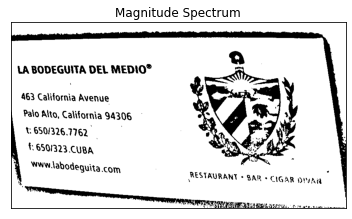

LA BODEGUITA DEL MEDIO®

463 California Avenue

Palo Alto, California 94306
%: 650/326.7762
£. 6501323 CUBA

Www.labodeguita.com RESTAURANT + BAR § C1G

LLL LL Le RLERNEN ERT pe, ee 4

AR DIVA

4
,


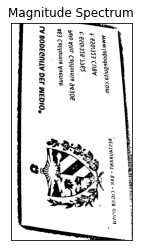

hee

 
 

el ssi Gehl Si NM a 9 YS

‘gE2LVABVAL oavis + CIC WEE

4

             

mum spogedmrg cow
4 201353 CNBY
fep0i3se'sseS
B90 yfEO" C a1)01v}9 av30e
903 CI/OLWII YAGUNG

FV BODECNILV DEF WEDIO,


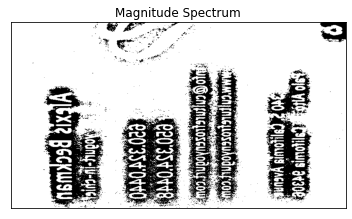

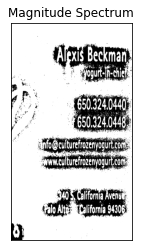

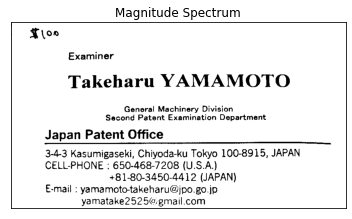

;

Too

Examiner

Takeharu YAMAMOTO

General Machinery Division
Second Patent Examination Department

Japan Patent Office

3-4-3 Kasumigaseki, Chiyoda-ku Tokyo 100-8915, JAPAN
CELL-PHONE : 650-468-7208 (U.S.A)
+81-80-3450-4412 (JAPAN)
E-mail : yamamoto-takeharu@jpo.go.jp
yamatake2525@.gmail.com


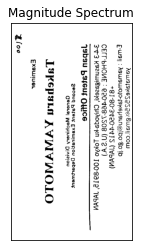

ASWIFSKES OS O@BWS!|' COW
E-Ws1| : ASLUSLUOJO-f9K6JSLN@!DO'Bo'lb
+8]-B0-3T20-WIS (VbvU)
CEIT-bHOUE |: e20-¥es-\508 (N’e'v’)
3-T3 KI2MWNES2EK!' CHIAOGS-KN LOKAO TOO-83T2" TWh
sbsu psreus OUICE

2ecoug _sfeur ExswiwefioU Debsipweus
Gevers) WECpIUELA DIAIzZIou

LIKepsL KVIATVIAOLO

Exswive

 

Lloo


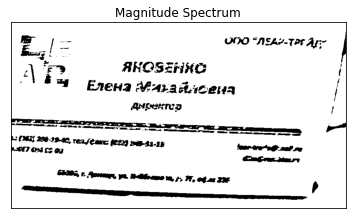

= = КО “ЛЕАР-ТОГ АД |

5.:!-

А’ ЯНОЗЕНЯС {

-' 9 Елена Млхайлсена |
дыремтоо !

 

}Д—д———ееЕЕеысны вы. —— —
жж

+: 264} 29-59-42) тел /еват: ТЗ 598-31-15 Зоне ^р.
».457 654 52 Фи бони

Яоиболя-мышит
2305 г. Домов уч. чбуанио 2 77, 04 м 8

ни


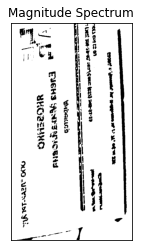

ЗАбаса \

. 2 Бенз музы вз \
$1 12 С
Роя зкоаЕмко
5 \- соо меча


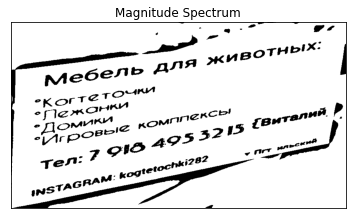

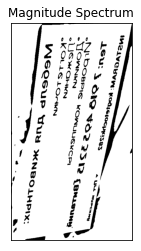

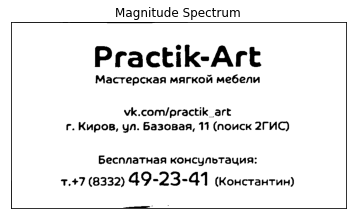

РгасК-АгЕ

Мастерская мягкой мебели

\К.согп/ргасНК_агЕ
г. Киров, ул. Базовая, 11 (поиск 2ГИС)

Бесплатная консультация:

т.+7 (8332) 49-23-41 (константин)


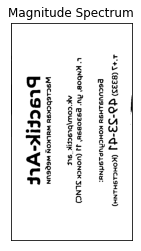

1+) (8335) 0-53-31 (консаэнамн)

Р6сум9АН9ы КОНСЙ\РА9Й мы:

с’ кмбов` Ам" рэзовэы` 11 (омск 5(МС)
Аксомлеэсик 9

уузсавбскэы мыьком ибобмы

БЕЭЗСИК-\ ЕЕ


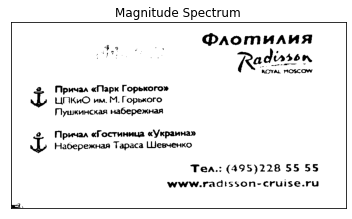

Флотилия

а Кадозь к.

ОМА. МО5СОУУ

Причал «Парк Горького»
ЦПКиО им. М. Горького
Пувшжинская набережная

Причал «Гостиница «Украина»
Набережная Тараса Шевченко

Тел.: (495)228 55 55
миуиуи.гаЯ: 553 оп-спизе.гы


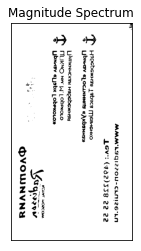

ммм-ьусиагоц-сыгигв`ьп
46°: (382)558 22 22

т нэосЬежняь | 363сз Левченко
$ МЬмяяу «росачиыйя «АкБямну»

ИМткмнскяы нзоеБежняч
ПОКНО миг ыГГОБРКОГО
ЦБмалэу «эк | ОБРКОКО»

о т

Фуошмумны


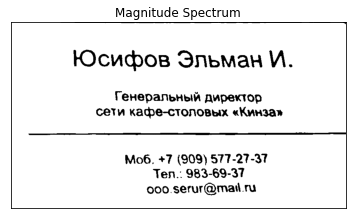

Юсифов Эльман М.

Генеральный директор
сети кафе-столовых «Кимза»

Моб. +7 (909) 577-27-37
Тел.: 983-69-37
осо. зегог@ тай га


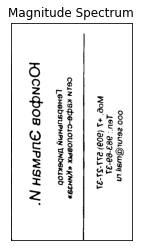

ооо‘гевии@шяутит
464`: 983-@д-3\
И06` +\ (909) 244-54-3\

селм кяфе-с1оцовтх «Кмнзэ»
Е 6небзиРнРМ УмЬвкоб

юсмфов ЭмцрРиэн М


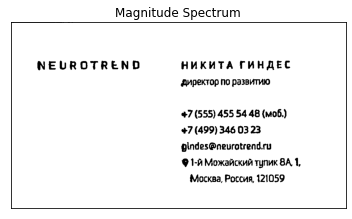

НЕОВОТВЕМО НИКИТА ГИНДЕС
директор по развитию

+7 (555) 455 54 48 (моб,)

+7 (499) 346 0323

иде @ипеигогеп .ги

1-й Можайский тупик 8А 1,
Москва, Россия, 121059


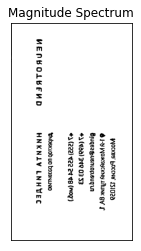

у\осквя` Боссму 151008
$ 1-м ИИожанскмы Линк ВУ Г
ЭгочбеФиуБЛЮЙ БИЛ
*+\ (20) 34° 03 53
+ (222) 422 24 48 (и00')

5обкаоь по Бэзвмимю
ИЕПКО4ВЕИО НМКМАУ ЕННУЕС


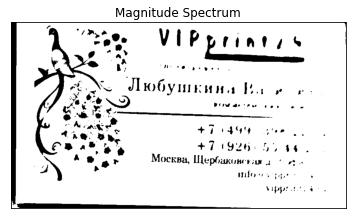

се. рии

№ `Любушь ина Наци г.

  

у з Ком ме сты ао ве
«ИОНЫ
о +7499 1...
№ - ог,
у +7190: 0,3%.

ль з^ Москва, Щербаковскля 1 д.
м »> ПЧ ›

Ур.


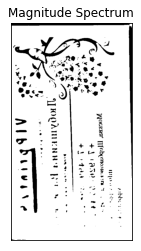

идоо:

ууосквя’ ГИеБочконскум 9, м
+у алого л +

"Зав пах

 

вом ще: .'

< *.


In [9]:
directory = writeDirectory
index=0
for fn in images[:]:
 
    ffn = directory + '/'+fn # имя файла, который будем анализировать
    img = cv.imread(ffn,0)
    ret, thresh4 = cv.threshold(img.astype(np.uint8), 0, 255, cv.THRESH_BINARY_INV)        
    
    plt.subplot(),plt.imshow(thresh4, cmap = 'gray')
    plt.title('Magnitude Spectrum'), plt.xticks([]), plt.yticks([])
    plt.show()
    if index < 88:
        language = 'eng'
    else:
        language = 'rus'
    print(pytesseract.image_to_string(thresh4 , lang = language))
    index+=1

# Постобработка

In [10]:
def showImage(imageForShowing):
    plt.figure(figsize = (10, 10))
    plt.imshow(imageForShowing, 'gray')

In [45]:
def ImRead(receivedfn):
    ffn = path + '\\res\\' + receivedfn    
    result = cv.imread(ffn, 0)  
    showImage(result)        
    return result

In [46]:
def MultiplyMinus1(imageForProcessing):
    result = np.zeros(imageShape)
    for x in range(imageShape[0]):
        for y in range(imageShape[1]):
            result[x, y] = imageForProcessing[x, y] * (-1)**(x + y) 
    return result

In [47]:
def PictureAnalysisAndTransform(receivedImage):
    
    #Умножаем пиксели изображения на (-1)**(x + y)
    shiftedImage = MultiplyMinus1(img)
    
    #Прямое преобразование Фурье
    f = np.fft.fft2(shiftedImage)
    magnitude_spectrum = np.log(np.abs(f))
    showImage(magnitude_spectrum)
    return f

In [53]:
def ImprooveImage(f, D0, n, snr):
    #Фильтр низких частот Баттерворта
    d = lambda u, v : math.sqrt((u - imageShape[0] / 2) ** 2 + (v - imageShape[1] / 2) ** 2)
    h = lambda df : 1 / (1 + (df / D0) ** (2 * n))
    
    #Фильтр Винера
    hw = lambda hf : hf / (abs(hf) * abs(hf) + 1 / snr)
    hwfilter = np.zeros(imageShape)
    for iu in range(imageShape[0]):
        for jv in range(imageShape[1]):
            hwfilter[iu, jv] = hw(h(d(iu, jv)))
    showImage(hwfilter)
    
    #Спектр после умножения на фильтр 
    f_hwfilter = f * hwfilter
    spectrum_hwfilter = np.power(np.abs(f_hwfilter), 0.3)
    showImage(spectrum_hwfilter)
    
    #Обратное преобразование Фурье
    image = np.abs(np.fft.ifft2(f_hwfilter))
    showImage(image)
    
    return image

In [73]:
def Recognizing(receivedImage, language):
    blured = cv.blur(receivedImage, (50, 50))
    deductedImage = Deduct(blured, img)
    cutedDeductedImage = deductedImage.copy()
    cutedDeductedImage[cutedDeductedImage < 0] = 0
    cutedDeductedImage[cutedDeductedImage > 255] = 0    
    ret, thresholdedImage = cv.threshold(cutedDeductedImage.astype(np.uint8), 0, 255, cv.THRESH_BINARY_INV + cv.THRESH_OTSU)  
    plt.subplot()    
    plt.imshow(thresholdedImage, cmap = 'gray')    
    plt.title('For recognizing'), plt.xticks([]), plt.yticks([])      
    plt.show()
    print(pytesseract.image_to_string(thresholdedImage , lang = language))

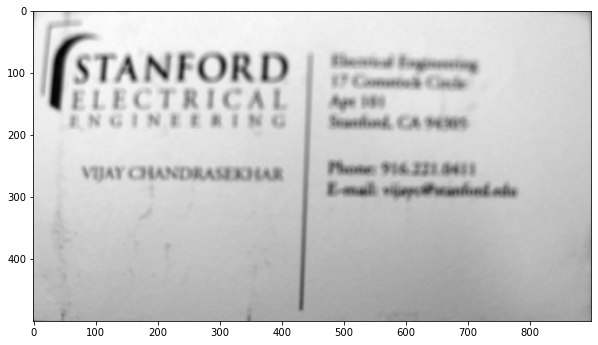

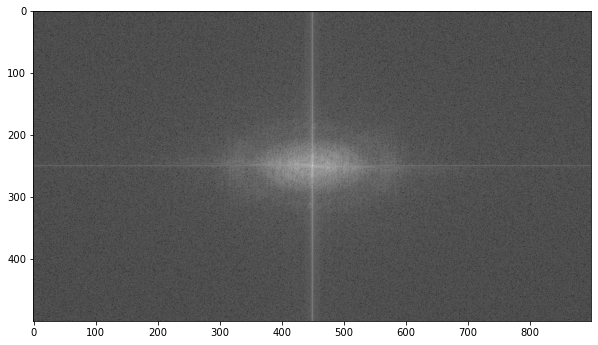

In [74]:
img = ImRead('004Hor.png')
imageShape = img.shape
f = PictureAnalysisAndTransform(img)

<ipython-input-73-53f0230e2a42>:8: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot()


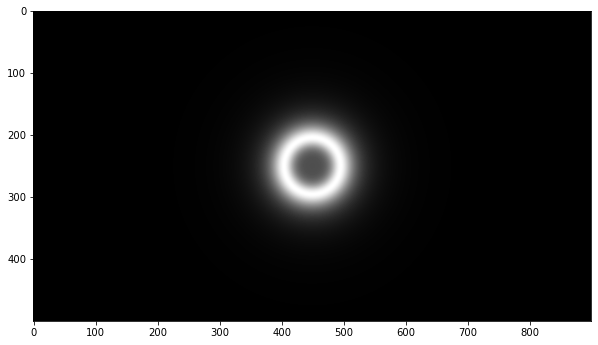

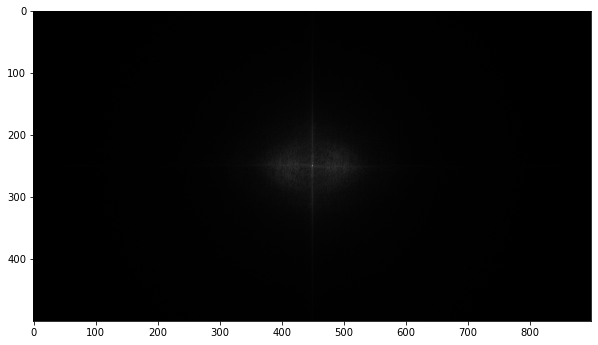

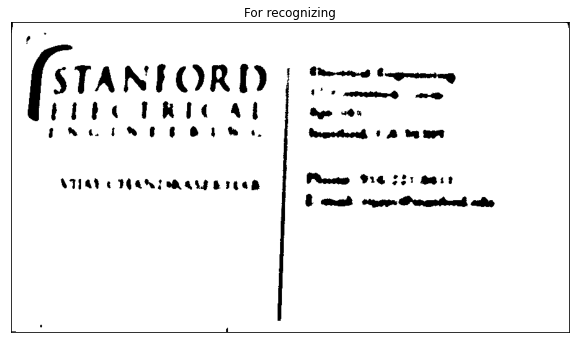

-

(STANFORD
t

Pha PRTC AL

peat nw tt Ota

ATION TUGND OM ASE RCO

ed Cgmenring

tee «Os
tmeeteods 1 2 tn BOT

Pence 914 53: Oeit
0 anak epee Penanteonl ache


In [79]:
D0 = 30
n = 2
snr = 40
improovedImage = ImprooveImage(f, D0, n, snr)
Recognizing(improovedImage, 'eng')

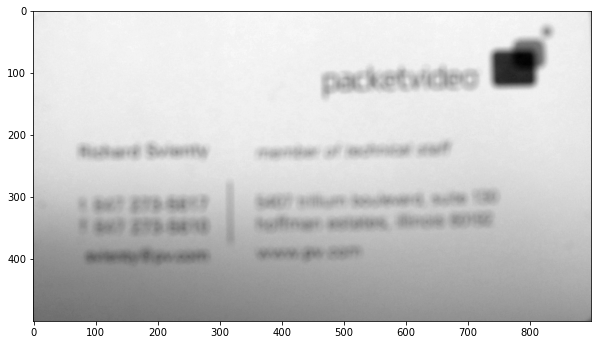

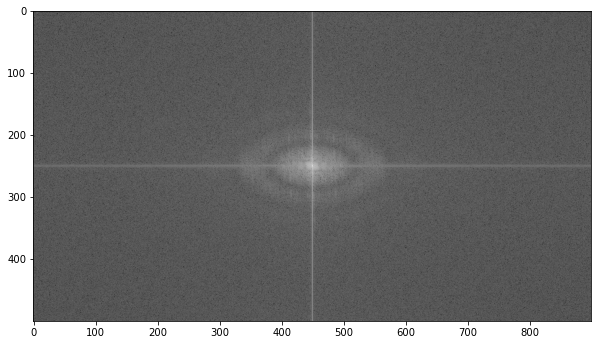

In [86]:
img = ImRead('008Hor.png')
imageShape = img.shape
f = PictureAnalysisAndTransform(img)

<ipython-input-73-53f0230e2a42>:8: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot()


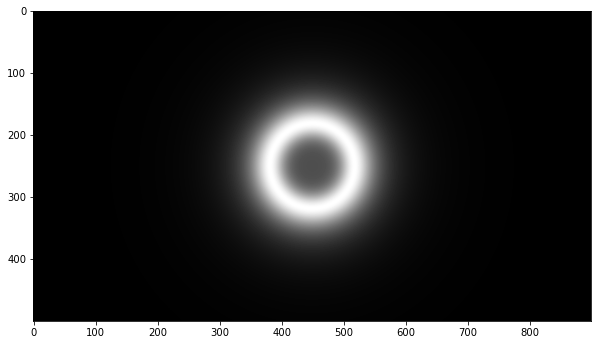

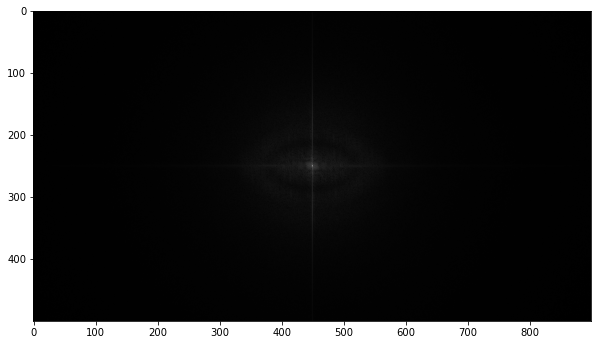

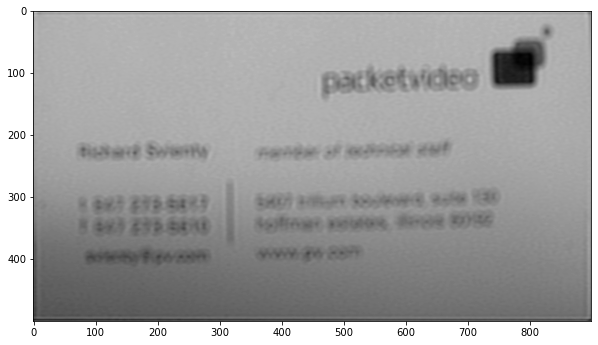

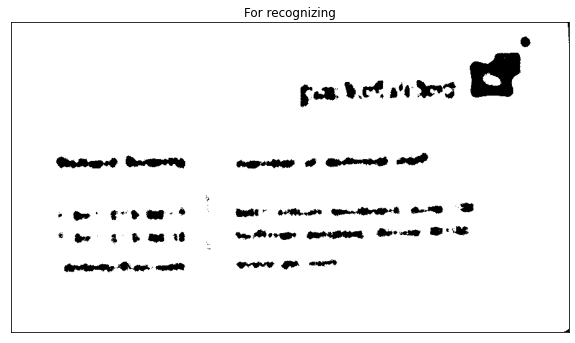

* ow fe aS
‘or 4b met

trtrtns B06 ee

°
cs bct seks ef

Pn Be ead

Rit ee ett oe
tn eve gumiem, Beo ee BOM

wey Goa


In [97]:
D0 = 45
n = 2
snr = 40
improovedImage = ImprooveImage(f, D0, n, snr)
showImage(improovedImage)
Recognizing(improovedImage, 'eng')

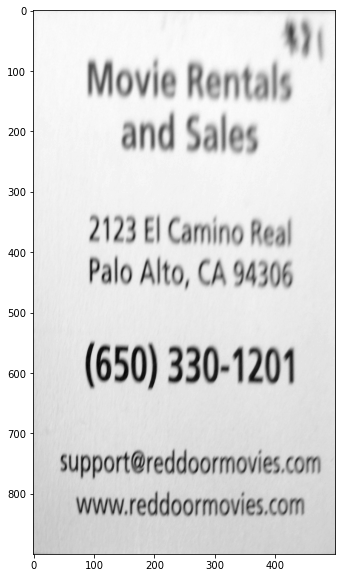

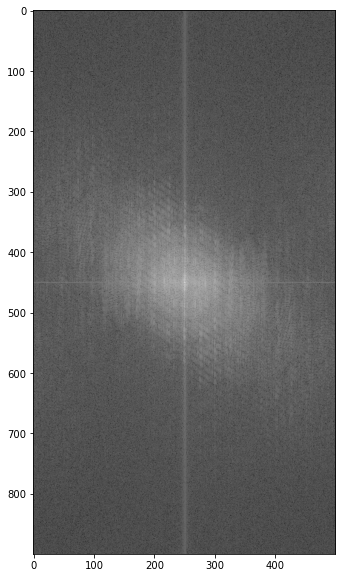

In [98]:
img = ImRead('081Vert.png')
imageShape = img.shape
f = PictureAnalysisAndTransform(img)

<ipython-input-73-53f0230e2a42>:8: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot()


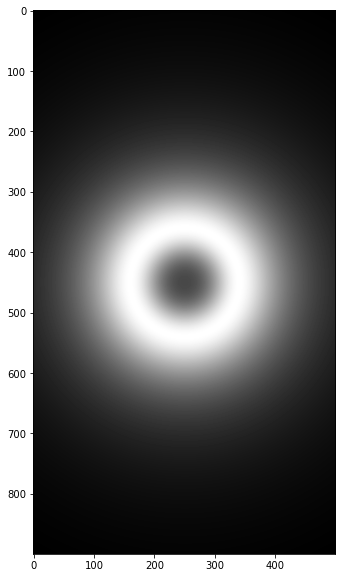

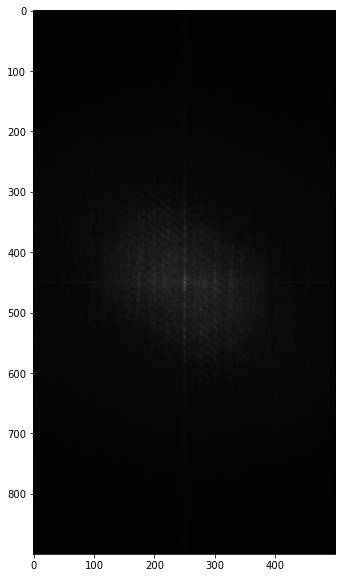

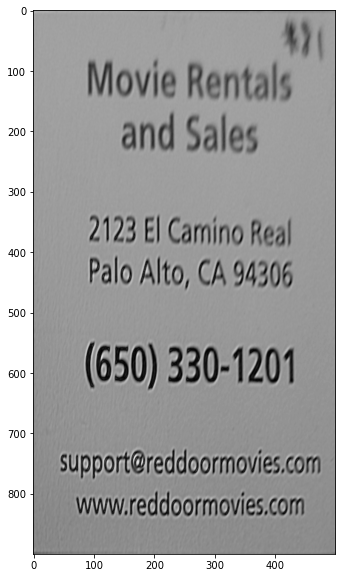

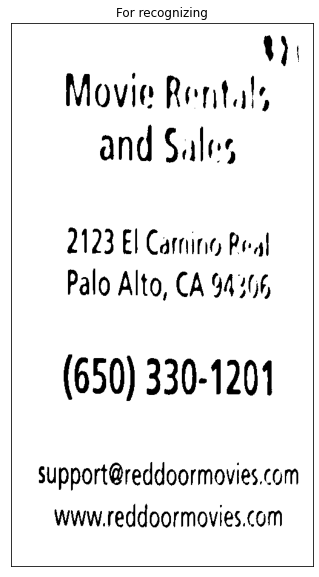

)}.
Movie Rentals
and Sales

2123 El Carninig Peal
Palo Alto, CA 94306

(650) 330-1201

support@reddoormovies.com
www.reddoormovies.com


In [102]:
D0 = 45
n = 1.2
snr = 40
improovedImage = ImprooveImage(f, D0, n, snr)
showImage(improovedImage)
Recognizing(improovedImage, 'eng')